In [1]:
%load_ext pretty_jupyter

In [2]:
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
warnings.simplefilter(action='ignore', category=UserWarning)

from datetime import date
import hisepy
import numpy as np
import os
import pandas as pd
import re
import scanpy as sc

## Helper functions

In [3]:
def cache_uuid_path(uuid):
    cache_path = '/home/jupyter/cache/{u}'.format(u = uuid)
    if not os.path.isdir(cache_path):
        hise_res = hisepy.reader.cache_files([uuid])
    filename = os.listdir(cache_path)[0]
    cache_file = '{p}/{f}'.format(p = cache_path, f = filename)
    return cache_file

In [4]:
def read_csv_uuid(uuid):
    cache_file = cache_uuid_path(uuid)
    res = pd.read_csv(cache_file)
    return res

In [5]:
def read_parquet_uuid(uuid):
    cache_file = cache_uuid_path(uuid)
    res = pd.read_parquet(cache_file)
    return res

In [6]:
def read_adata_uuid(uuid):
    cache_file = cache_uuid_path(uuid)
    res = sc.read_h5ad(cache_file)
    return res

In [7]:
def backed_adata_uuid(uuid):
    cache_file = cache_uuid_path(uuid)
    res = sc.read_h5ad(cache_file, backed = 'r')
    return res

In [8]:
def rm_cache_uuid(uuid):
    cache_path = '/home/jupyter/cache/{u}'.format(u = uuid)
    rm_call = 'rm -r {d}'.format(d = cache_path)
    os.system(rm_call)

In [9]:
def format_cell_type(cell_type):
    cell_type = re.sub('\\+', 'pos', cell_type)
    cell_type = re.sub('-', 'neg', cell_type)
    cell_type = re.sub(' ', '_', cell_type)
    return cell_type

In [10]:
def filename_cell_type(filename):
    cell_type = re.sub('.+L3_','',filename)
    cell_type = re.sub('_2024.+','',cell_type)
    cell_type = re.sub('_', ' ', cell_type)
    cell_type = re.sub('pos','+', cell_type)
    cell_type = re.sub('neg','-', cell_type)
    return cell_type

In [11]:
def add_labels(adata, labels):
    obs = adata.obs
    obs = obs.reset_index(drop = True)
    obs = obs.merge(labels, on = 'barcodes', how = 'left')
    obs = obs.set_index('barcodes', drop = False)
    adata.obs = obs
    return adata

In [12]:
def element_id(n = 3):
    import periodictable
    from random import randrange
    rand_el = []
    for i in range(n):
        el = randrange(0,118)
        rand_el.append(periodictable.elements[el].name)
    rand_str = '-'.join(rand_el)
    return rand_str

## Markers for dotplots

In [13]:
broad_markers = [
    'CD3D', # T cells
    'CD3E', # T cells/NK
    'FCN1', # Monocytes/Myeloid
    'HBB', # Erythrocytes
    'MS4A1', # B cells
    'CD79A', # B cells
    'PPBP', # Platelets
    'IFI44L' # ISG-high
]

In [14]:
class_markers = [
    'CD4',
    'CD8A',
    'CD27',
    'GZMB',
    'GZMK',
    'IFI44L',
    'IKZF2',
    'KLRB1',
    'KLRF1',
    'SOX4',
    'TRAC',
    'TRDC',
    'TRDV1',
    'TRDV2'
]

## Read previous, non-tracked labels
We ran a preliminary analysis of our dataset that wasn't tracked for reproducibility. Here, we'll retrieve the labels for visualization and comparison to check for consistency.

In [15]:
original_uuid = '3868592c-0087-4ed8-98b2-4bf1b8676111'
original_df = read_parquet_uuid(original_uuid)
original_df = original_df[['barcodes', 'AIFI_L1', 'AIFI_L2', 'AIFI_L3']]
original_df = original_df.rename({'AIFI_L1': 'original_L1', 'AIFI_L2': 'original_L2', 'AIFI_L3': 'original_L3'}, axis = 1)

In [16]:
original_df.head()

,barcodes,original_L1,original_L2,original_L3
0,05ea9806794211eb93b836d1cb6129eb,DC,cDC1,cDC1
1,e225c914794011eb9282e2ceeb91ba52,DC,cDC1,cDC1
2,b1379eae795411eb958b0245821e6993,DC,cDC1,cDC1
3,b13d3a8a795411eb958b0245821e6993,DC,cDC1,cDC1
4,b1430d16795411eb958b0245821e6993,DC,cDC1,cDC1


## Read cell type hierarchy

In [17]:
hierarchy_uuid = '1a44252c-8cab-4c8f-92c9-d8f3af633790'
hierarchy_df = read_csv_uuid(hierarchy_uuid)

## Identify files for use in HISE

In [18]:
search_id = 'darmstadtium-francium-dubnium'

Retrieve files stored in our HISE project store

In [19]:
ps_df = hisepy.list_files_in_project_store('cohorts')
ps_df = ps_df[['id', 'name']]

Filter for files from the previous notebook using our search_id

In [20]:
search_df = ps_df[ps_df['name'].str.contains(search_id)]
search_df = search_df.sort_values('name')
search_df['AIFI_L3'] = [filename_cell_type(f) for f in search_df['name']]

In [21]:
search_df['AIFI_L3'].tolist()

['CD4 MAIT',
 'CD8 MAIT',
 'DN T cell',
 'GZMB+ Vd2 gdT',
 'GZMK+ Vd2 gdT',
 'GZMK+ memory CD4 Treg',
 'HBB+ MAIT',
 'ISG+ MAIT',
 'KLRB1+ memory CD4 Treg',
 'KLRB1+ memory CD8 Treg',
 'KLRF1- effector Vd1 gdT',
 'KLRF1+ effector Vd1 gdT',
 'Memory CD4 Treg',
 'Memory CD8 Treg',
 'Naive CD4 Treg',
 'Naive Vd1 gdT',
 'Proliferating T cell',
 'SOX4+ Vd1 gdT']

# MAIT

## Review CD4 MAIT

In [22]:
cell_type = 'CD4 MAIT'
type_uuid = search_df['id'].loc[search_df['AIFI_L3'] == cell_type].tolist()[0]

In [23]:
type_uuid

'7a707d33-c302-43a4-bfb2-17b178e72b1b'

In [24]:
adata = read_adata_uuid(type_uuid)

### Clustering

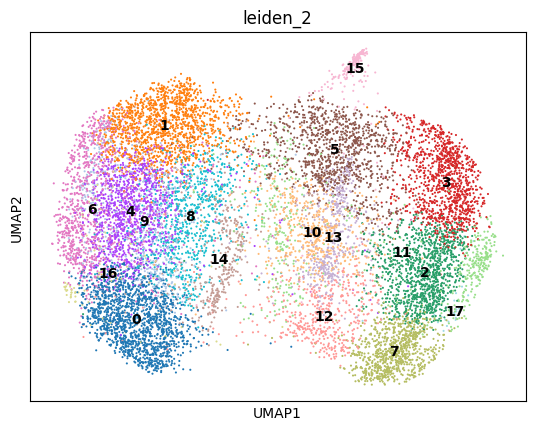

In [25]:
sc.pl.umap(adata, color = 'leiden_2', legend_loc = 'on data')

### Marker expression

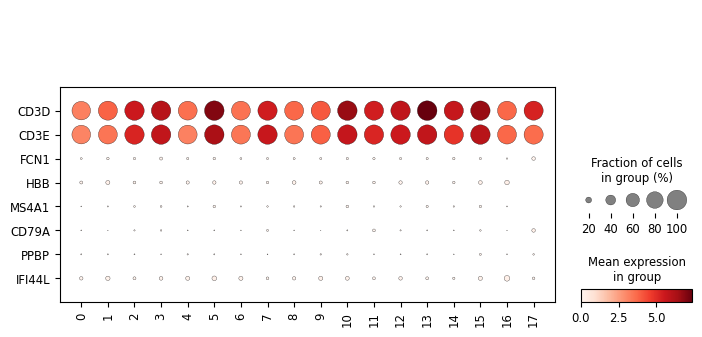

In [26]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = broad_markers, swap_axes = True)

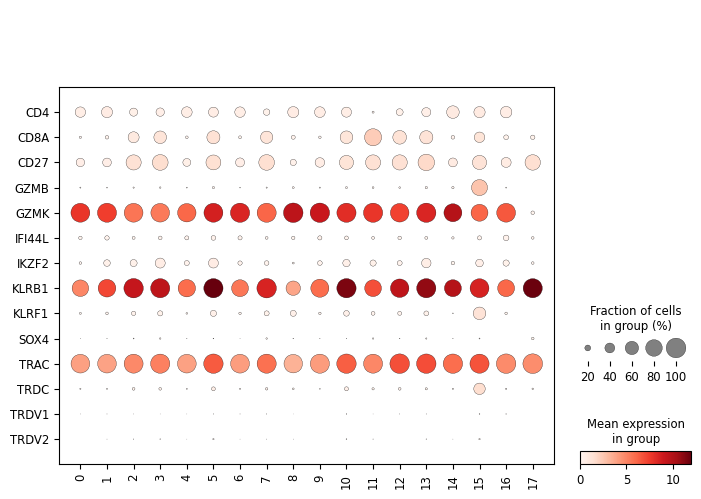

In [27]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = class_markers, swap_axes = True)

### Cluster counts

In [28]:
adata.obs['leiden_2'].value_counts()

leiden_2
0     1546
1     1378
2     1138
3     1109
4     1071
5     1050
6      988
7      834
8      756
9      589
10     545
11     522
12     481
13     457
14     412
15     207
16     106
17      29
Name: count, dtype: int64

### Outlier investigation

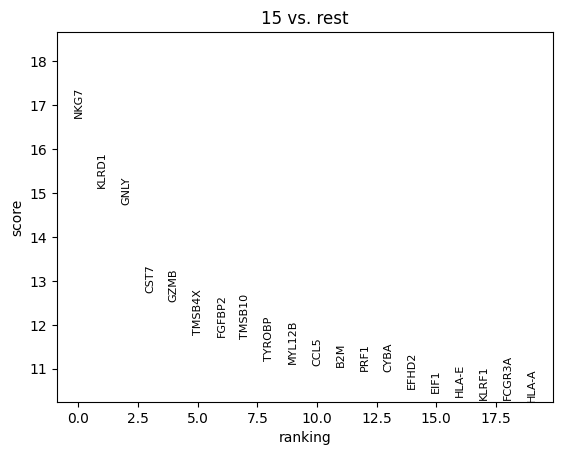

In [29]:
sc.tl.rank_genes_groups(
    adata, 
    groupby = 'leiden_2', 
    groups = ['15']
)
sc.pl.rank_genes_groups(adata)

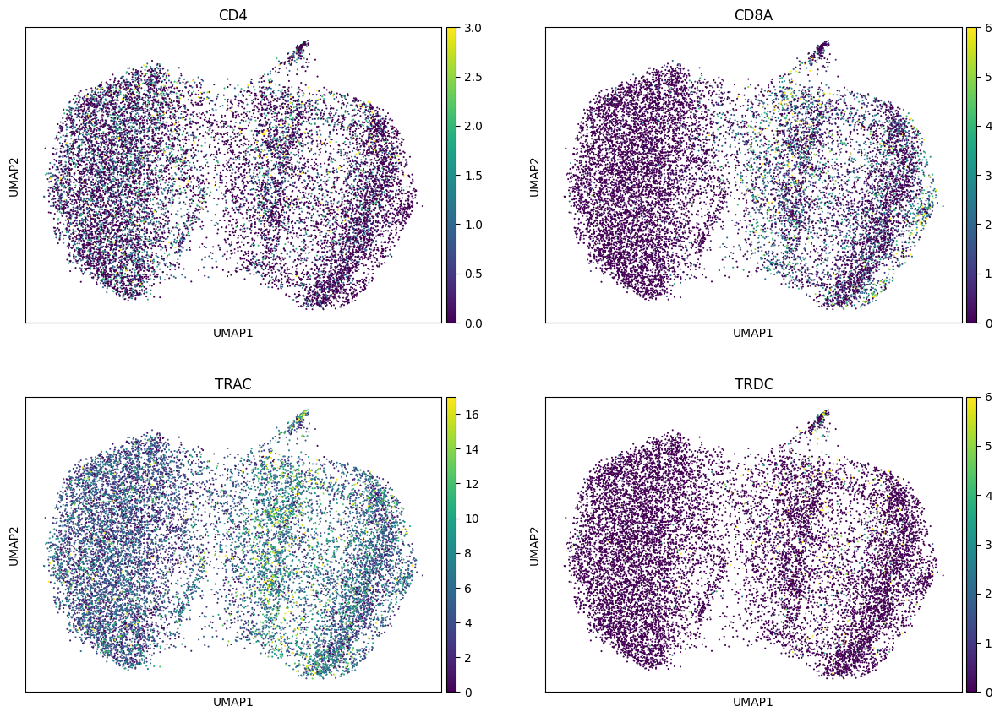

In [30]:
sc.pl.umap(adata, color = ['CD4','CD8A', 'TRAC', 'TRDC'], vmax = 'p99', ncols = 2)

### Comparison to original labels

In [31]:
adata = add_labels(adata, original_df)

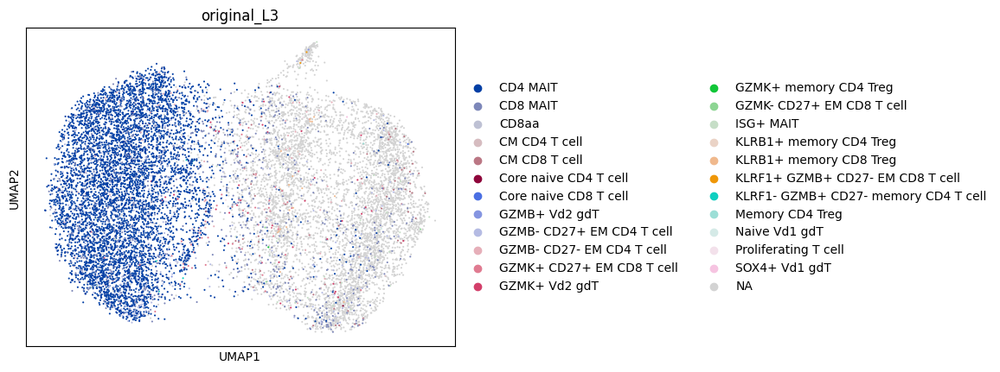

In [32]:
sc.pl.umap(adata, color = 'original_L3')

In [33]:
adata.obs['original_L3'].value_counts(dropna = False)

original_L3
CD4 MAIT                                5814
NaN                                     5680
CD8 MAIT                                 943
GZMB- CD27+ EM CD4 T cell                422
GZMB- CD27- EM CD4 T cell                107
CM CD8 T cell                             64
GZMK+ Vd2 gdT                             55
GZMK+ CD27+ EM CD8 T cell                 53
ISG+ MAIT                                 33
KLRB1+ memory CD8 Treg                    18
KLRF1- GZMB+ CD27- memory CD4 T cell       6
CM CD4 T cell                              3
Proliferating T cell                       3
GZMK- CD27+ EM CD8 T cell                  3
Naive Vd1 gdT                              2
GZMB+ Vd2 gdT                              2
KLRB1+ memory CD4 Treg                     2
KLRF1+ GZMB+ CD27- EM CD8 T cell           2
SOX4+ Vd1 gdT                              1
CD8aa                                      1
Memory CD4 Treg                            1
Core naive CD8 T cell                      

In [34]:
adata.obs['original_L3'].value_counts(dropna = False) / adata.obs.shape[0]

original_L3
CD4 MAIT                                0.439855
NaN                                     0.429717
CD8 MAIT                                0.071342
GZMB- CD27+ EM CD4 T cell               0.031926
GZMB- CD27- EM CD4 T cell               0.008095
CM CD8 T cell                           0.004842
GZMK+ Vd2 gdT                           0.004161
GZMK+ CD27+ EM CD8 T cell               0.004010
ISG+ MAIT                               0.002497
KLRB1+ memory CD8 Treg                  0.001362
KLRF1- GZMB+ CD27- memory CD4 T cell    0.000454
CM CD4 T cell                           0.000227
Proliferating T cell                    0.000227
GZMK- CD27+ EM CD8 T cell               0.000227
Naive Vd1 gdT                           0.000151
GZMB+ Vd2 gdT                           0.000151
KLRB1+ memory CD4 Treg                  0.000151
KLRF1+ GZMB+ CD27- EM CD8 T cell        0.000151
SOX4+ Vd1 gdT                           0.000076
CD8aa                                   0.000076
Memory C

### Proposed updates

- Reassign CD8A-high clusters as CD8 MAIT

## Review CD8 MAIT

In [35]:
cell_type = 'CD8 MAIT'
type_uuid = search_df['id'].loc[search_df['AIFI_L3'] == cell_type].tolist()[0]

In [36]:
type_uuid

'c73bbbec-9383-41e3-8aff-b65f64e56cb5'

In [37]:
adata = read_adata_uuid(type_uuid)

### Clustering

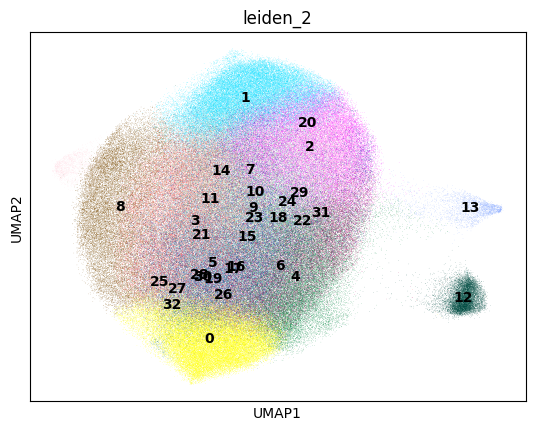

In [38]:
sc.pl.umap(adata, color = 'leiden_2', legend_loc = 'on data')

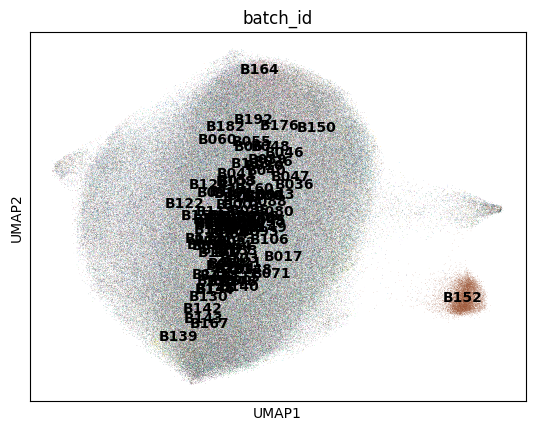

In [39]:
sc.pl.umap(adata, color = 'batch_id', legend_loc = 'on data')

### Marker expression

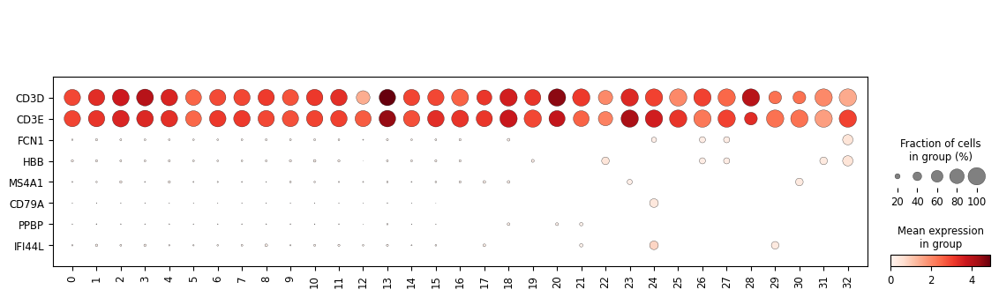

In [40]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = broad_markers, swap_axes = True)

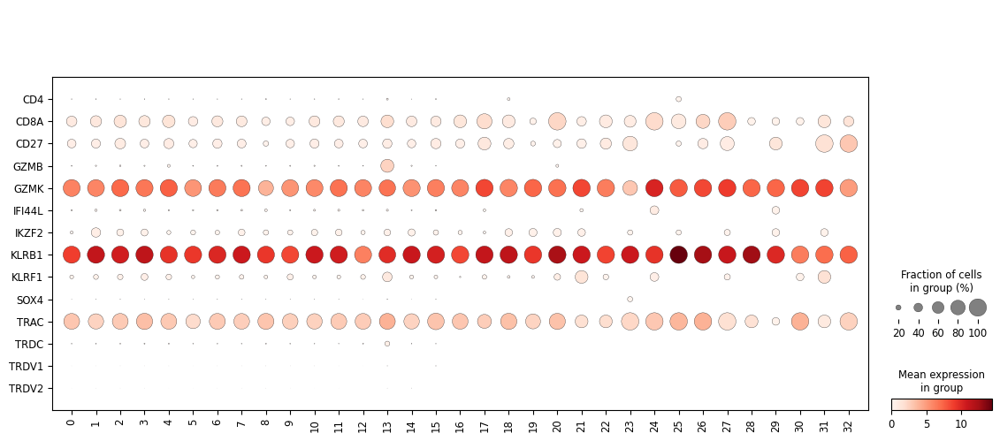

In [41]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = class_markers, swap_axes = True)

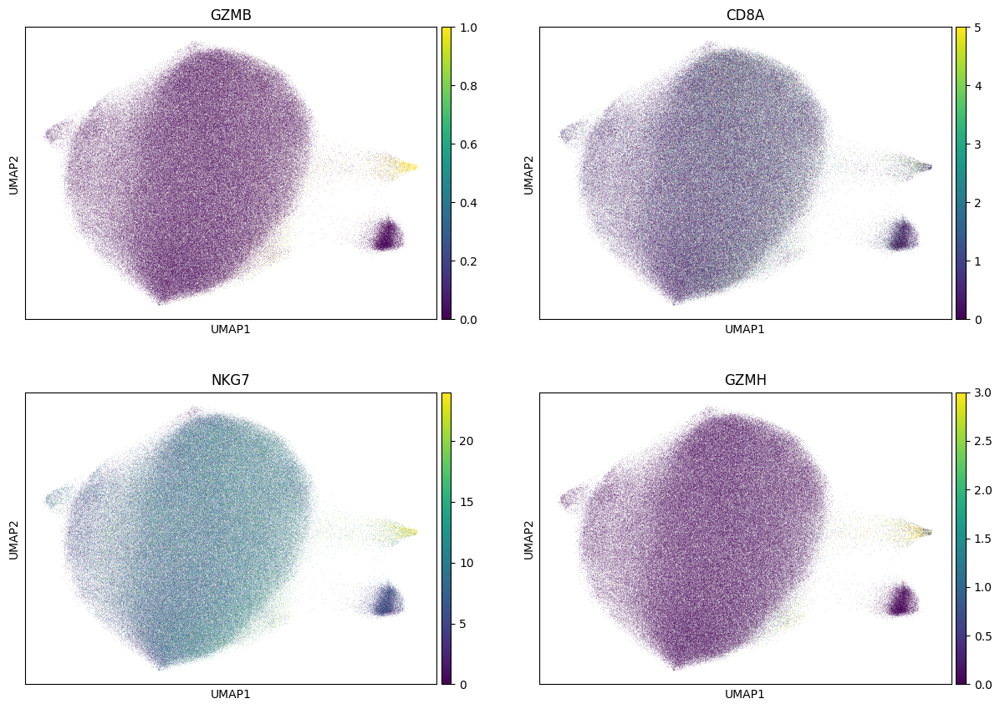

In [42]:
sc.pl.umap(adata, color = ['GZMB','CD8A', 'NKG7', 'GZMH'], vmax = 'p99', ncols = 2)

### Cluster counts

In [43]:
adata.obs['leiden_2'].value_counts()

leiden_2
0     41058
1     39297
2     32897
3     29701
4     29379
5     26762
6     26364
7     26271
8     25037
9     20302
10    16811
11    15116
12    10939
13     3096
14      518
15      294
16       33
17       12
18       12
19       11
20       11
21        9
22        9
23        5
24        5
25        5
26        4
27        4
28        3
29        3
30        3
31        3
32        2
Name: count, dtype: int64

### Investigate outliers

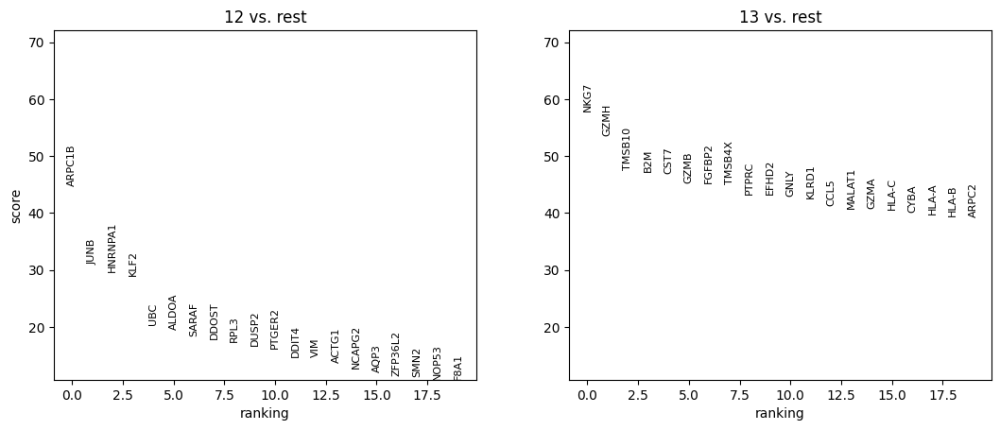

In [44]:
sc.tl.rank_genes_groups(
    adata, 
    groupby = 'leiden_2', 
    groups = ['12','13']
)
sc.pl.rank_genes_groups(adata)

### Comparison to original labels

In [45]:
adata = add_labels(adata, original_df)

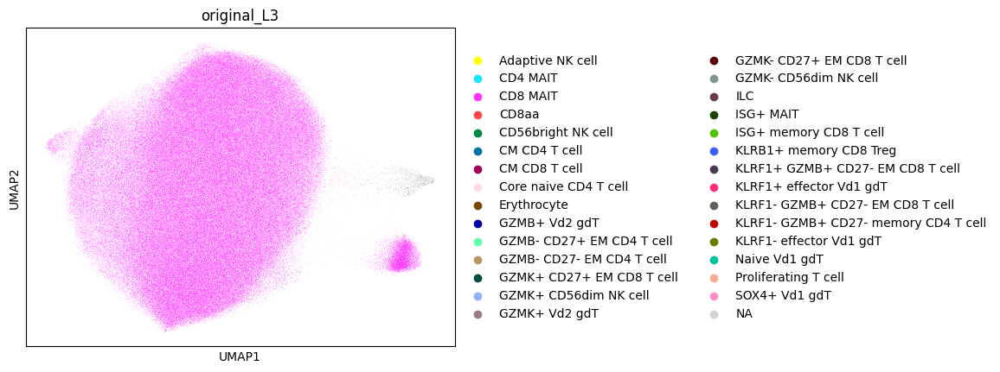

In [46]:
sc.pl.umap(adata, color = 'original_L3')

In [47]:
adata.obs['original_L3'].value_counts(dropna = False)

original_L3
CD8 MAIT                                321836
NaN                                      15134
CD4 MAIT                                  2135
GZMK+ Vd2 gdT                             1769
GZMB- CD27+ EM CD4 T cell                 1081
ISG+ MAIT                                  884
GZMK+ CD27+ EM CD8 T cell                  554
GZMB- CD27- EM CD4 T cell                  117
KLRF1- GZMB+ CD27- memory CD4 T cell       104
KLRF1- GZMB+ CD27- EM CD8 T cell           102
GZMB+ Vd2 gdT                               61
CM CD8 T cell                               60
GZMK- CD27+ EM CD8 T cell                   35
KLRF1+ GZMB+ CD27- EM CD8 T cell            26
GZMK+ CD56dim NK cell                       25
CD8aa                                        8
GZMK- CD56dim NK cell                        7
CM CD4 T cell                                7
Proliferating T cell                         7
Erythrocyte                                  5
Core naive CD4 T cell                        4
K

In [48]:
adata.obs['original_L3'].value_counts(dropna = False) / adata.obs.shape[0]

original_L3
CD8 MAIT                                0.935635
NaN                                     0.043997
CD4 MAIT                                0.006207
GZMK+ Vd2 gdT                           0.005143
GZMB- CD27+ EM CD4 T cell               0.003143
ISG+ MAIT                               0.002570
GZMK+ CD27+ EM CD8 T cell               0.001611
GZMB- CD27- EM CD4 T cell               0.000340
KLRF1- GZMB+ CD27- memory CD4 T cell    0.000302
KLRF1- GZMB+ CD27- EM CD8 T cell        0.000297
GZMB+ Vd2 gdT                           0.000177
CM CD8 T cell                           0.000174
GZMK- CD27+ EM CD8 T cell               0.000102
KLRF1+ GZMB+ CD27- EM CD8 T cell        0.000076
GZMK+ CD56dim NK cell                   0.000073
CD8aa                                   0.000023
GZMK- CD56dim NK cell                   0.000020
CM CD4 T cell                           0.000020
Proliferating T cell                    0.000020
Erythrocyte                             0.000015
Core nai

### Proposed updates

- Remove GZMH-high clusters as mislabeled

## Review HBB+ MAIT

In [49]:
cell_type = 'HBB+ MAIT'
type_uuid = search_df['id'].loc[search_df['AIFI_L3'] == cell_type].tolist()[0]

In [50]:
type_uuid

'5ada56bd-14d0-48a3-9672-ab94d3251f37'

In [51]:
adata = read_adata_uuid(type_uuid)

### Clusters

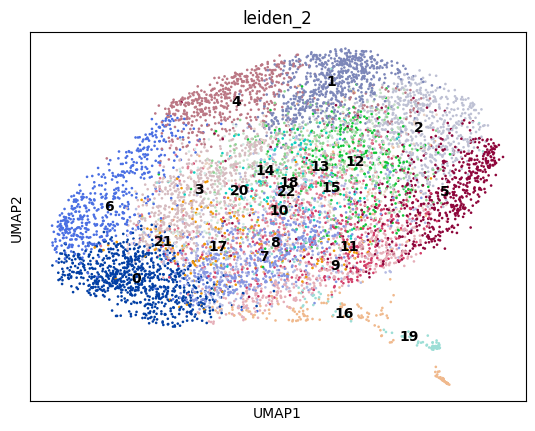

In [52]:
sc.pl.umap(adata, color = 'leiden_2', legend_loc = 'on data')

### Marker expression

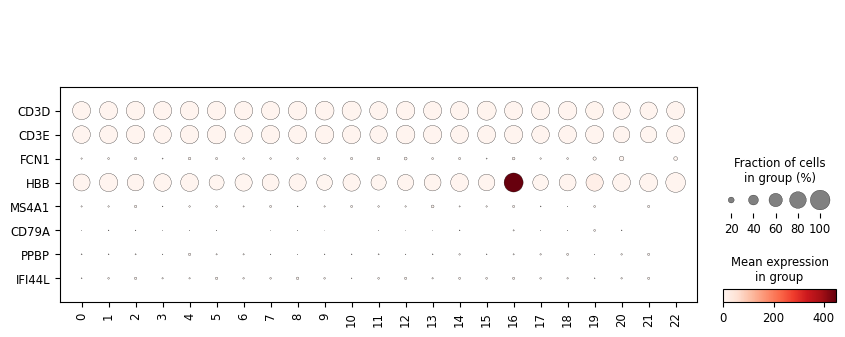

In [53]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = broad_markers, swap_axes = True)

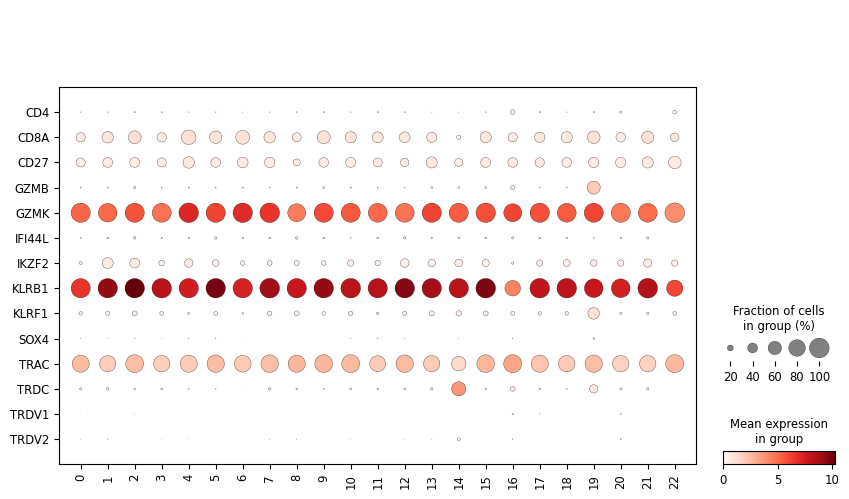

In [54]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = class_markers, swap_axes = True)

### Cluster counts

In [55]:
adata.obs['leiden_2'].value_counts()

leiden_2
0     827
1     694
2     648
3     603
4     587
5     569
6     553
7     520
8     418
9     417
10    377
11    334
12    283
13    279
14    255
15    247
16    208
17    167
18    130
19    119
20     63
21     19
22      9
Name: count, dtype: int64

### Comparison to original labels

In [56]:
adata = add_labels(adata, original_df)

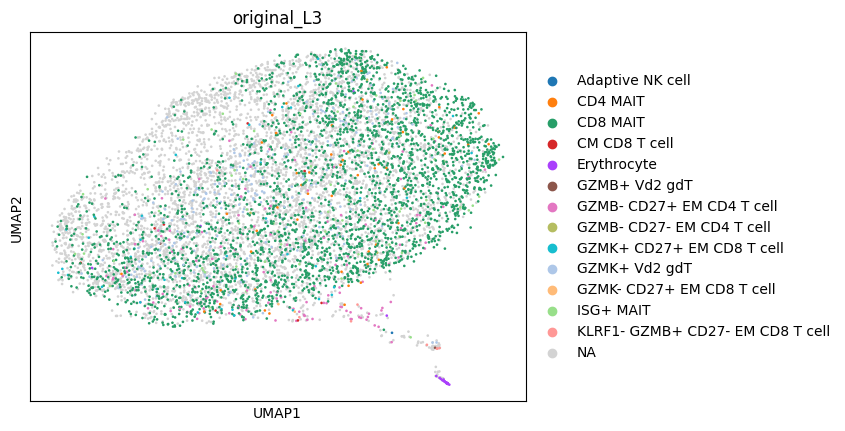

In [57]:
sc.pl.umap(adata, color = 'original_L3')

In [58]:
adata.obs['original_L3'].value_counts(dropna = False)

original_L3
NaN                                 4887
CD8 MAIT                            2796
GZMK+ Vd2 gdT                        272
GZMB- CD27+ EM CD4 T cell            142
ISG+ MAIT                             76
CD4 MAIT                              55
GZMK+ CD27+ EM CD8 T cell             41
Erythrocyte                           32
CM CD8 T cell                          8
KLRF1- GZMB+ CD27- EM CD8 T cell       8
GZMB- CD27- EM CD4 T cell              4
GZMB+ Vd2 gdT                          2
GZMK- CD27+ EM CD8 T cell              2
Adaptive NK cell                       1
Name: count, dtype: int64

In [59]:
adata.obs['original_L3'].value_counts(dropna = False) / adata.obs.shape[0]

original_L3
NaN                                 0.586957
CD8 MAIT                            0.335816
GZMK+ Vd2 gdT                       0.032669
GZMB- CD27+ EM CD4 T cell           0.017055
ISG+ MAIT                           0.009128
CD4 MAIT                            0.006606
GZMK+ CD27+ EM CD8 T cell           0.004924
Erythrocyte                         0.003843
CM CD8 T cell                       0.000961
KLRF1- GZMB+ CD27- EM CD8 T cell    0.000961
GZMB- CD27- EM CD4 T cell           0.000480
GZMB+ Vd2 gdT                       0.000240
GZMK- CD27+ EM CD8 T cell           0.000240
Adaptive NK cell                    0.000120
Name: count, dtype: float64

### Proposed updates

- Remove from analysis - HBB+ were not present in original reference

## Review ISG+ MAIT

In [60]:
cell_type = 'ISG+ MAIT'
type_uuid = search_df['id'].loc[search_df['AIFI_L3'] == cell_type].tolist()[0]

In [61]:
type_uuid

'7a17a651-8936-4801-99cc-1e0101e1163f'

In [62]:
adata = read_adata_uuid(type_uuid)

### Clustering

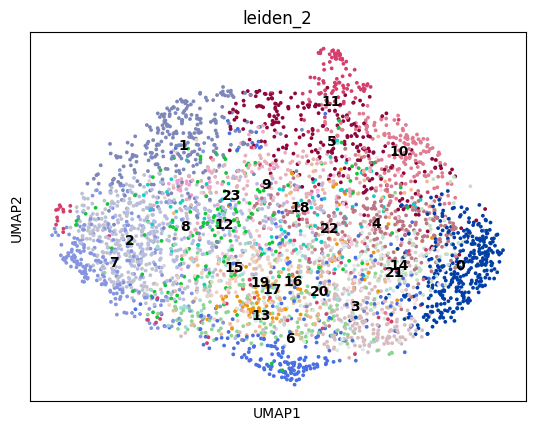

In [63]:
sc.pl.umap(adata, color = 'leiden_2', legend_loc = 'on data')

### Marker expression

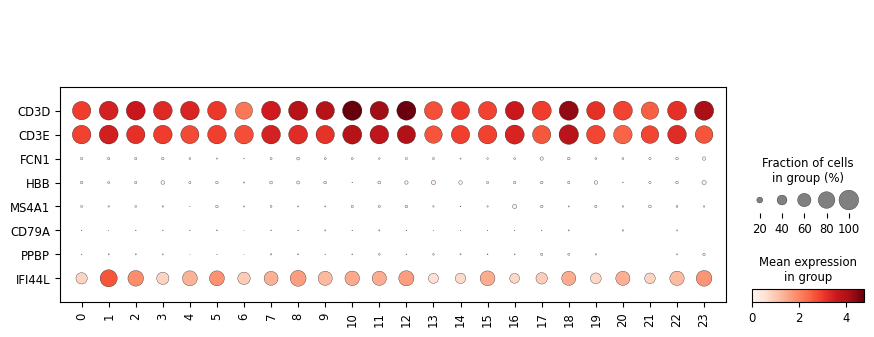

In [64]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = broad_markers, swap_axes = True)

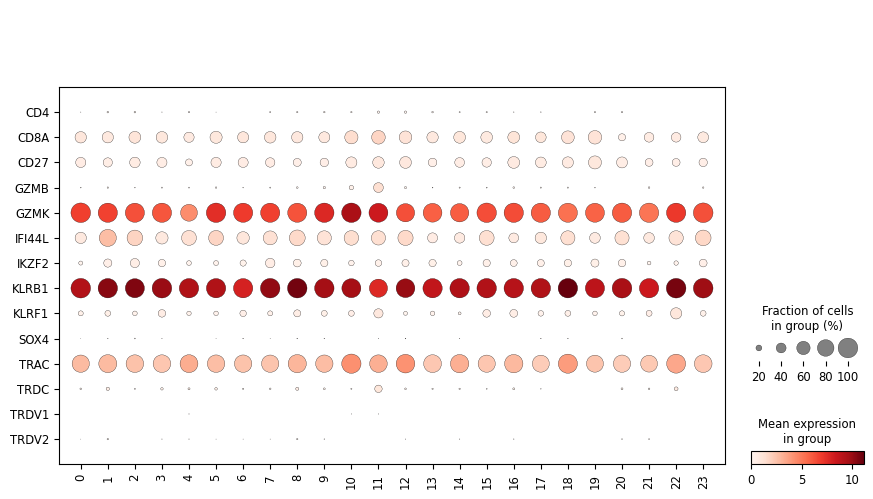

In [65]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = class_markers, swap_axes = True)

### Cluster counts

In [66]:
adata.obs['leiden_2'].value_counts()

leiden_2
0     350
1     301
2     298
3     279
4     257
5     251
6     246
7     241
8     230
9     181
10    171
11    153
12    151
13    139
14    130
15    112
16    106
17     86
18     85
19     69
20     65
21     54
22     44
23     31
Name: count, dtype: int64

### Comparison to original labels

In [67]:
adata = add_labels(adata, original_df)

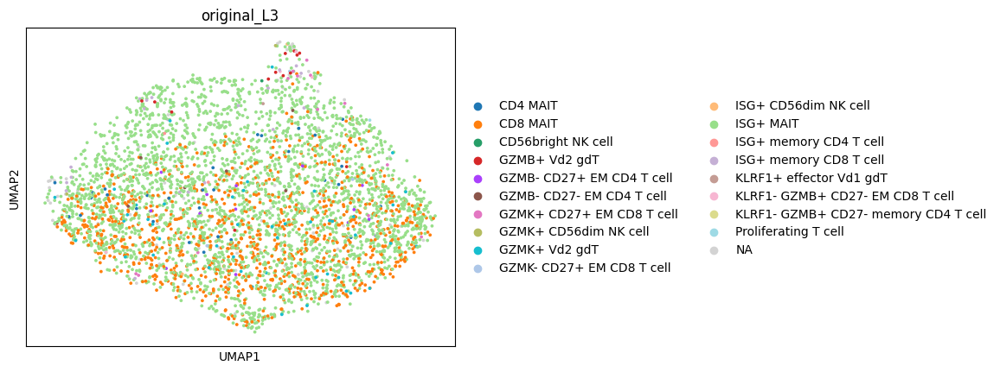

In [68]:
sc.pl.umap(adata, color = 'original_L3')

In [69]:
adata.obs['original_L3'].value_counts(dropna = False)

original_L3
ISG+ MAIT                               2808
CD8 MAIT                                 945
NaN                                      113
GZMK+ Vd2 gdT                             47
CD4 MAIT                                  31
ISG+ memory CD8 T cell                    22
GZMB- CD27+ EM CD4 T cell                 14
GZMB+ Vd2 gdT                             14
GZMK+ CD27+ EM CD8 T cell                 13
GZMB- CD27- EM CD4 T cell                  6
KLRF1- GZMB+ CD27- EM CD8 T cell           4
GZMK- CD27+ EM CD8 T cell                  3
GZMK+ CD56dim NK cell                      2
ISG+ CD56dim NK cell                       2
ISG+ memory CD4 T cell                     2
CD56bright NK cell                         1
KLRF1+ effector Vd1 gdT                    1
KLRF1- GZMB+ CD27- memory CD4 T cell       1
Proliferating T cell                       1
Name: count, dtype: int64

In [70]:
adata.obs['original_L3'].value_counts(dropna = False) / adata.obs.shape[0]

original_L3
ISG+ MAIT                               0.696774
CD8 MAIT                                0.234491
NaN                                     0.028040
GZMK+ Vd2 gdT                           0.011663
CD4 MAIT                                0.007692
ISG+ memory CD8 T cell                  0.005459
GZMB- CD27+ EM CD4 T cell               0.003474
GZMB+ Vd2 gdT                           0.003474
GZMK+ CD27+ EM CD8 T cell               0.003226
GZMB- CD27- EM CD4 T cell               0.001489
KLRF1- GZMB+ CD27- EM CD8 T cell        0.000993
GZMK- CD27+ EM CD8 T cell               0.000744
GZMK+ CD56dim NK cell                   0.000496
ISG+ CD56dim NK cell                    0.000496
ISG+ memory CD4 T cell                  0.000496
CD56bright NK cell                      0.000248
KLRF1+ effector Vd1 gdT                 0.000248
KLRF1- GZMB+ CD27- memory CD4 T cell    0.000248
Proliferating T cell                    0.000248
Name: count, dtype: float64

### Proposed updates

No proposed changes

## Review DN T cell

In [71]:
cell_type = 'DN T cell'
type_uuid = search_df['id'].loc[search_df['AIFI_L3'] == cell_type].tolist()[0]

In [72]:
type_uuid

'ff91c063-1ed7-43c5-9aed-eb9850d83905'

In [73]:
adata = read_adata_uuid(type_uuid)

### Clustering

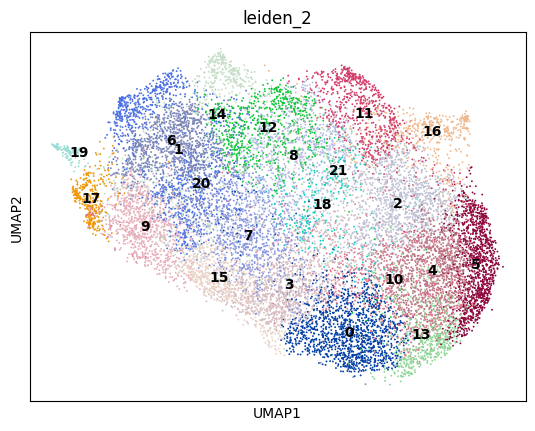

In [74]:
sc.pl.umap(adata, color = 'leiden_2', legend_loc = 'on data')

### Marker expression

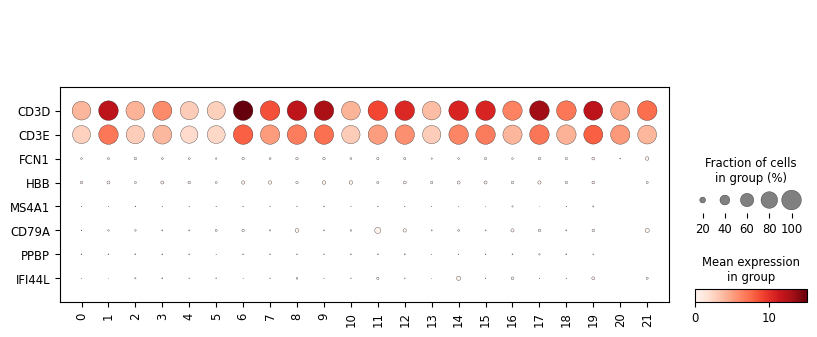

In [75]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = broad_markers, swap_axes = True)

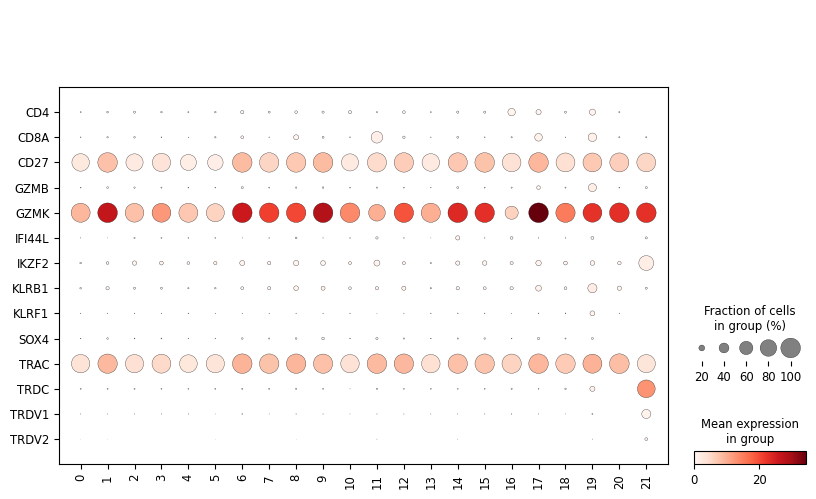

In [76]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = class_markers, swap_axes = True)

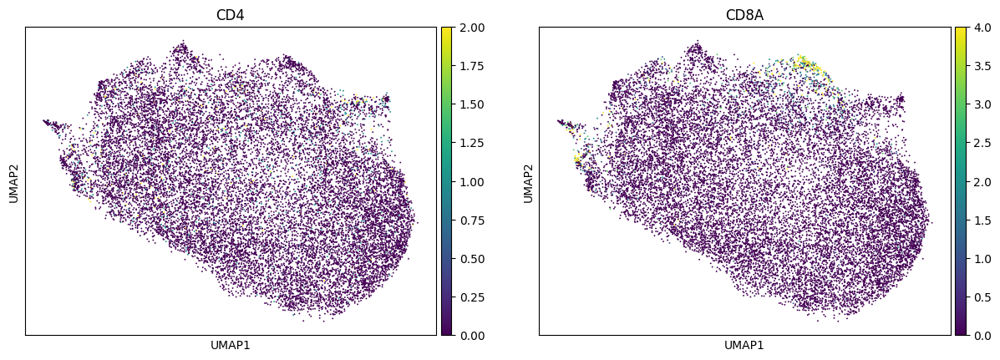

In [77]:
sc.pl.umap(adata, color = ['CD4','CD8A'], vmax = 'p99')

### Comparison to original labels

In [78]:
adata = add_labels(adata, original_df)

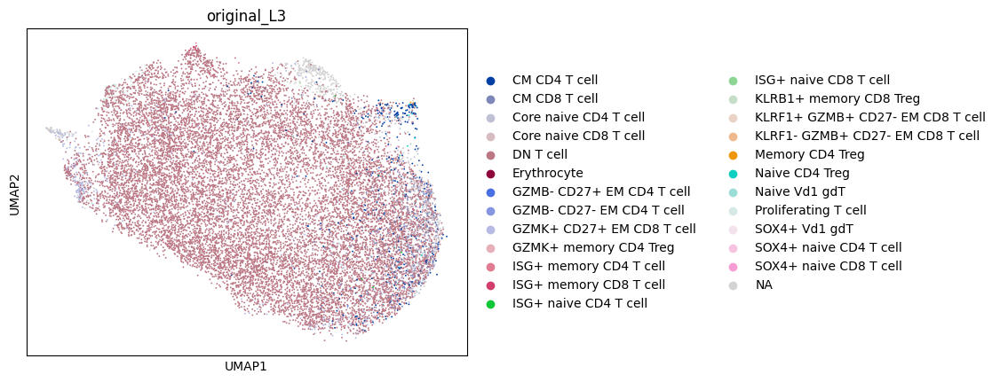

In [79]:
sc.pl.umap(adata, color = 'original_L3')

In [80]:
adata.obs['original_L3'].value_counts(dropna = False)

original_L3
DN T cell                           14265
NaN                                   605
GZMK+ CD27+ EM CD8 T cell             427
CM CD4 T cell                         367
Core naive CD4 T cell                 355
CM CD8 T cell                         332
Core naive CD8 T cell                 208
Proliferating T cell                   68
Naive CD4 Treg                         20
GZMK+ memory CD4 Treg                  17
ISG+ memory CD8 T cell                 16
GZMB- CD27+ EM CD4 T cell              14
Naive Vd1 gdT                          13
SOX4+ naive CD4 T cell                 10
SOX4+ Vd1 gdT                           7
ISG+ naive CD4 T cell                   5
ISG+ memory CD4 T cell                  4
KLRF1+ GZMB+ CD27- EM CD8 T cell        3
GZMB- CD27- EM CD4 T cell               3
Memory CD4 Treg                         2
Erythrocyte                             2
SOX4+ naive CD8 T cell                  2
KLRF1- GZMB+ CD27- EM CD8 T cell        1
ISG+ naive CD8 T cell 

In [81]:
adata.obs['original_L3'].value_counts(dropna = False) / adata.obs.shape[0]

original_L3
DN T cell                           0.851743
NaN                                 0.036124
GZMK+ CD27+ EM CD8 T cell           0.025496
CM CD4 T cell                       0.021913
Core naive CD4 T cell               0.021197
CM CD8 T cell                       0.019823
Core naive CD8 T cell               0.012419
Proliferating T cell                0.004060
Naive CD4 Treg                      0.001194
GZMK+ memory CD4 Treg               0.001015
ISG+ memory CD8 T cell              0.000955
GZMB- CD27+ EM CD4 T cell           0.000836
Naive Vd1 gdT                       0.000776
SOX4+ naive CD4 T cell              0.000597
SOX4+ Vd1 gdT                       0.000418
ISG+ naive CD4 T cell               0.000299
ISG+ memory CD4 T cell              0.000239
KLRF1+ GZMB+ CD27- EM CD8 T cell    0.000179
GZMB- CD27- EM CD4 T cell           0.000179
Memory CD4 Treg                     0.000119
Erythrocyte                         0.000119
SOX4+ naive CD8 T cell              0.00011

### Proposed updates

No proposed changes

# Treg

## Review GZMK+ memory CD4 Treg

In [82]:
cell_type = 'GZMK+ memory CD4 Treg'
type_uuid = search_df['id'].loc[search_df['AIFI_L3'] == cell_type].tolist()[0]

In [83]:
type_uuid

'ae391fc0-16df-4bbe-86a1-55e6aefe79d5'

In [84]:
adata = read_adata_uuid(type_uuid)

### Clustering

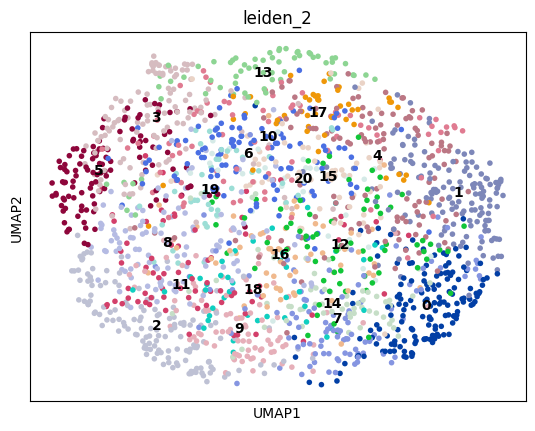

In [85]:
sc.pl.umap(adata, color = 'leiden_2', legend_loc = 'on data')

### Marker expression

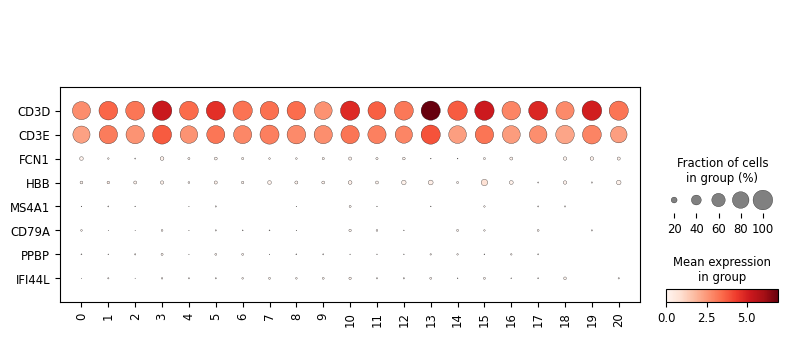

In [86]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = broad_markers, swap_axes = True)

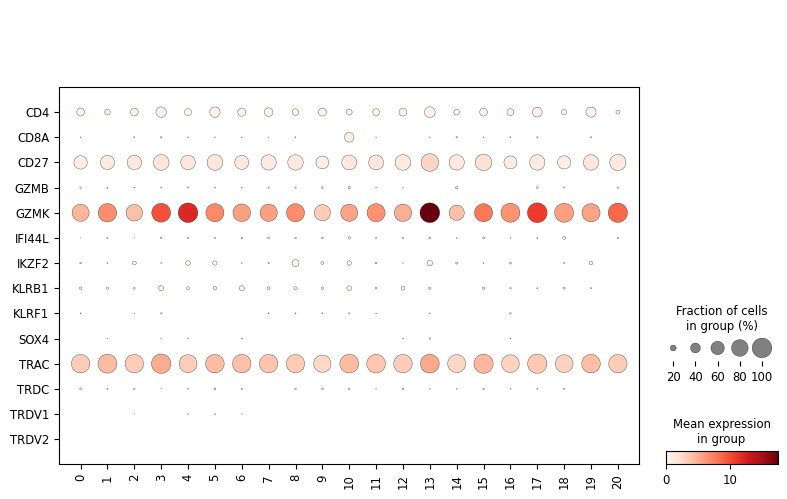

In [87]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = class_markers, swap_axes = True)

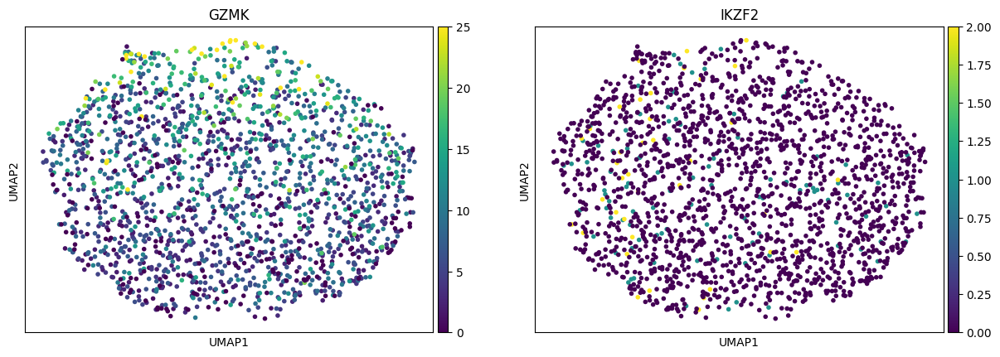

In [88]:
sc.pl.umap(adata, color = ['GZMK','IKZF2'], vmax = 'p99')

### Comparison to original labels

In [89]:
adata = add_labels(adata, original_df)

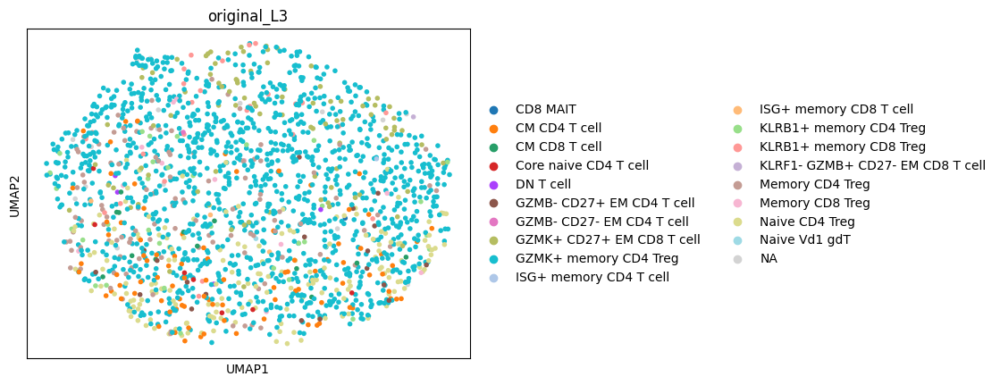

In [90]:
sc.pl.umap(adata, color = 'original_L3')

In [91]:
adata.obs['original_L3'].value_counts(dropna = False)

original_L3
GZMK+ memory CD4 Treg               1255
Naive CD4 Treg                       175
Memory CD4 Treg                      109
CM CD4 T cell                         91
GZMK+ CD27+ EM CD8 T cell             90
KLRB1+ memory CD4 Treg                32
KLRB1+ memory CD8 Treg                26
GZMB- CD27+ EM CD4 T cell             19
NaN                                   18
CM CD8 T cell                         14
Memory CD8 Treg                       12
Core naive CD4 T cell                  7
DN T cell                              4
ISG+ memory CD8 T cell                 3
Naive Vd1 gdT                          1
CD8 MAIT                               1
KLRF1- GZMB+ CD27- EM CD8 T cell       1
GZMB- CD27- EM CD4 T cell              1
ISG+ memory CD4 T cell                 1
Name: count, dtype: int64

In [92]:
adata.obs['original_L3'].value_counts(dropna = False) / adata.obs.shape[0]

original_L3
GZMK+ memory CD4 Treg               0.674731
Naive CD4 Treg                      0.094086
Memory CD4 Treg                     0.058602
CM CD4 T cell                       0.048925
GZMK+ CD27+ EM CD8 T cell           0.048387
KLRB1+ memory CD4 Treg              0.017204
KLRB1+ memory CD8 Treg              0.013978
GZMB- CD27+ EM CD4 T cell           0.010215
NaN                                 0.009677
CM CD8 T cell                       0.007527
Memory CD8 Treg                     0.006452
Core naive CD4 T cell               0.003763
DN T cell                           0.002151
ISG+ memory CD8 T cell              0.001613
Naive Vd1 gdT                       0.000538
CD8 MAIT                            0.000538
KLRF1- GZMB+ CD27- EM CD8 T cell    0.000538
GZMB- CD27- EM CD4 T cell           0.000538
ISG+ memory CD4 T cell              0.000538
Name: count, dtype: float64

### Proposed updates

No proposed changes

## Review KLRB1+ memory CD4 Treg

In [93]:
cell_type = 'KLRB1+ memory CD4 Treg'
type_uuid = search_df['id'].loc[search_df['AIFI_L3'] == cell_type].tolist()[0]

In [94]:
type_uuid

'b8234e80-375e-4101-a009-e47711a2fbbf'

In [95]:
adata = read_adata_uuid(type_uuid)

### Clustering

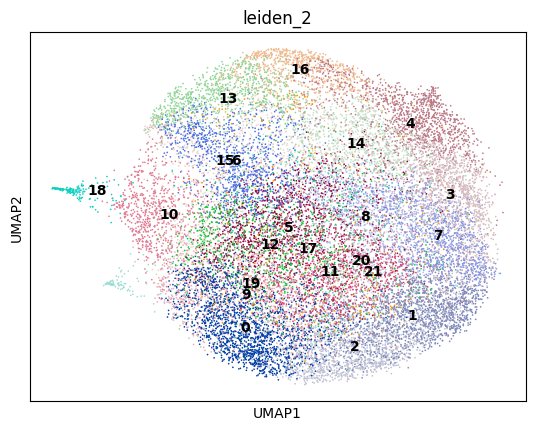

In [96]:
sc.pl.umap(adata, color = 'leiden_2', legend_loc = 'on data')

### Marker expression

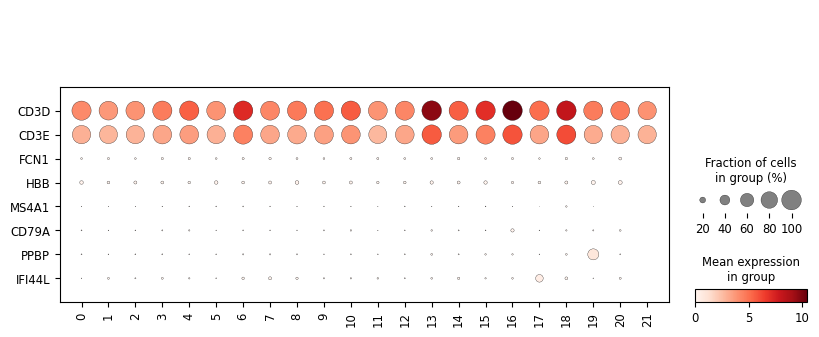

In [97]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = broad_markers, swap_axes = True)

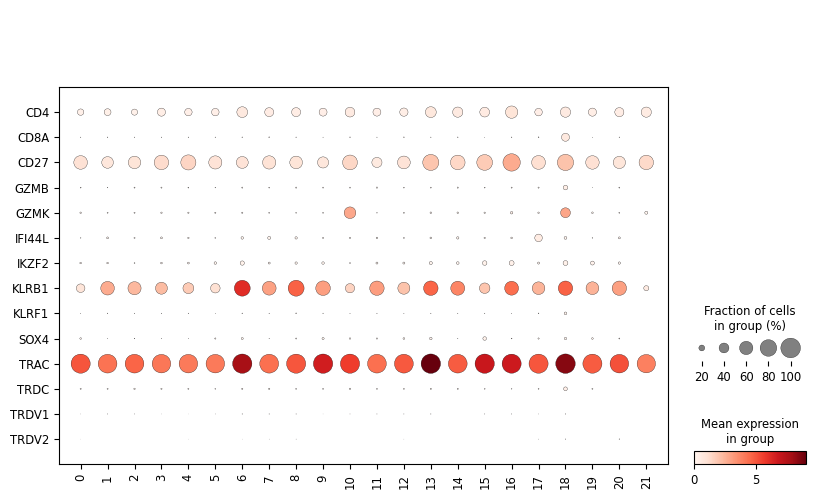

In [98]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = class_markers, swap_axes = True)

### Outlier investigation

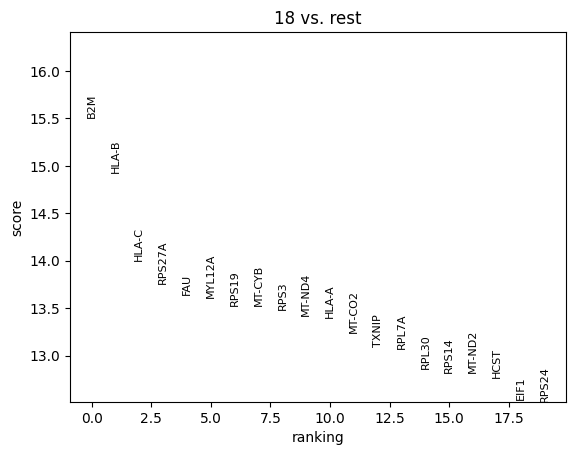

In [99]:
sc.tl.rank_genes_groups(
    adata, 
    groupby = 'leiden_2', 
    groups = ['18']
)
sc.pl.rank_genes_groups(adata)

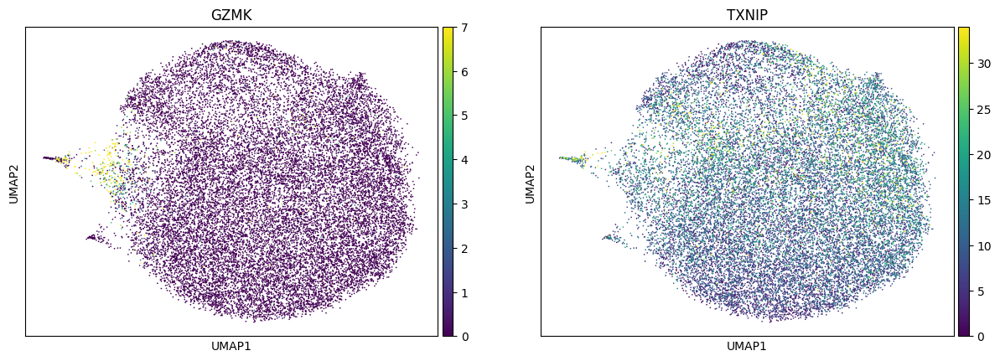

In [100]:
sc.pl.umap(adata, color = ['GZMK','TXNIP'], vmax = 'p99')

### Comparison to original labels

In [101]:
adata = add_labels(adata, original_df)

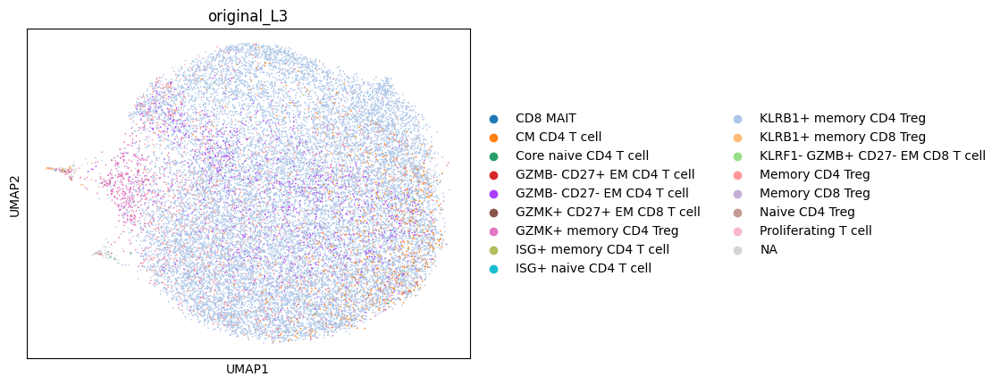

In [102]:
sc.pl.umap(adata, color = 'original_L3')

In [103]:
adata.obs['original_L3'].value_counts(dropna = False)

original_L3
KLRB1+ memory CD4 Treg              16748
Memory CD4 Treg                      1256
GZMB- CD27- EM CD4 T cell            1011
GZMK+ memory CD4 Treg                 727
CM CD4 T cell                         657
NaN                                   240
Naive CD4 Treg                        189
KLRB1+ memory CD8 Treg                 29
Proliferating T cell                   20
Memory CD8 Treg                        17
Core naive CD4 T cell                  13
ISG+ memory CD4 T cell                 13
GZMB- CD27+ EM CD4 T cell               8
GZMK+ CD27+ EM CD8 T cell               8
CD8 MAIT                                2
KLRF1- GZMB+ CD27- EM CD8 T cell        2
ISG+ naive CD4 T cell                   2
Name: count, dtype: int64

In [104]:
adata.obs['original_L3'].value_counts(dropna = False) / adata.obs.shape[0]

original_L3
KLRB1+ memory CD4 Treg              0.799733
Memory CD4 Treg                     0.059975
GZMB- CD27- EM CD4 T cell           0.048276
GZMK+ memory CD4 Treg               0.034715
CM CD4 T cell                       0.031372
NaN                                 0.011460
Naive CD4 Treg                      0.009025
KLRB1+ memory CD8 Treg              0.001385
Proliferating T cell                0.000955
Memory CD8 Treg                     0.000812
Core naive CD4 T cell               0.000621
ISG+ memory CD4 T cell              0.000621
GZMB- CD27+ EM CD4 T cell           0.000382
GZMK+ CD27+ EM CD8 T cell           0.000382
CD8 MAIT                            0.000096
KLRF1- GZMB+ CD27- EM CD8 T cell    0.000096
ISG+ naive CD4 T cell               0.000096
Name: count, dtype: float64

### Proposed updates

Remove GZMK-high cluster as mislabeled

## Review KLRB1+ memory CD8 Treg

In [105]:
cell_type = 'KLRB1+ memory CD8 Treg'
type_uuid = search_df['id'].loc[search_df['AIFI_L3'] == cell_type].tolist()[0]

In [106]:
type_uuid

'7eda2fb3-9de4-46bd-b2c8-c5064f1d4817'

In [107]:
adata = read_adata_uuid(type_uuid)

### Clustering

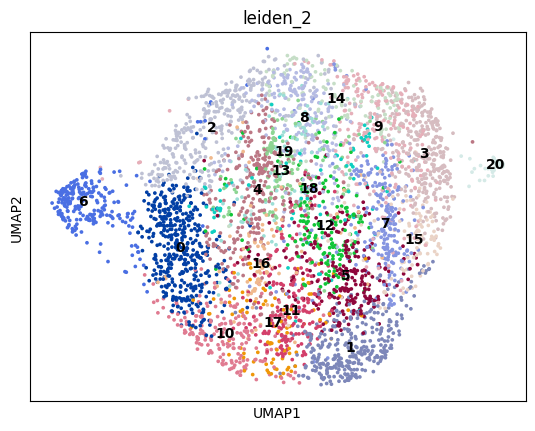

In [108]:
sc.pl.umap(adata, color = 'leiden_2', legend_loc = 'on data')

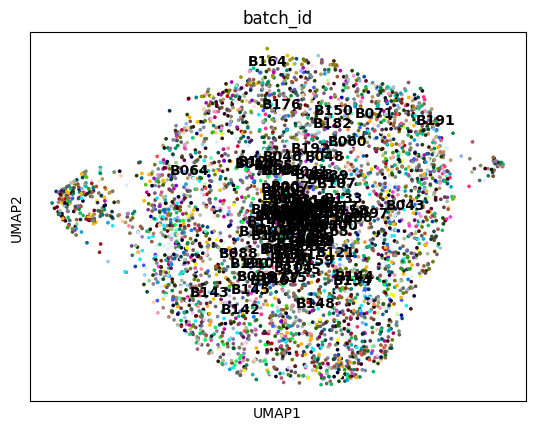

In [109]:
sc.pl.umap(adata, color = 'batch_id', legend_loc = 'on data')

### Marker expression

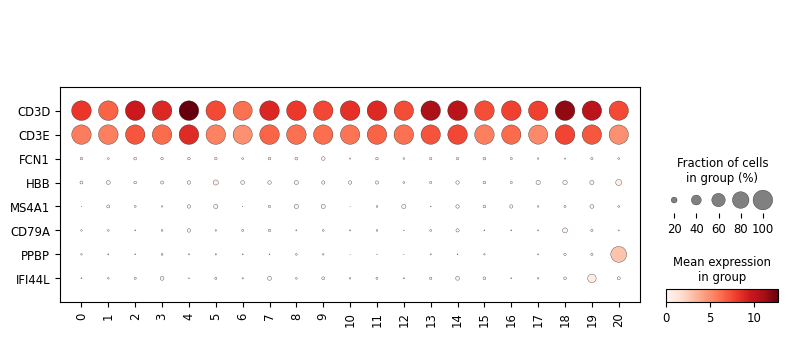

In [110]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = broad_markers, swap_axes = True)

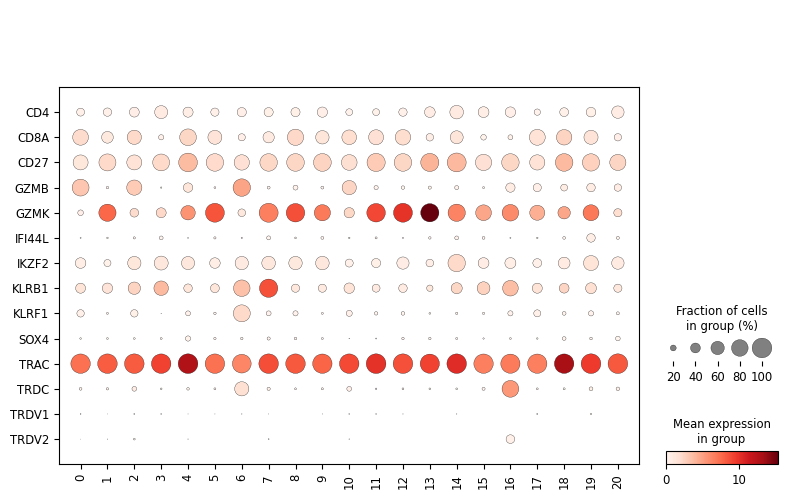

In [111]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = class_markers, swap_axes = True)

### Outlier investigation

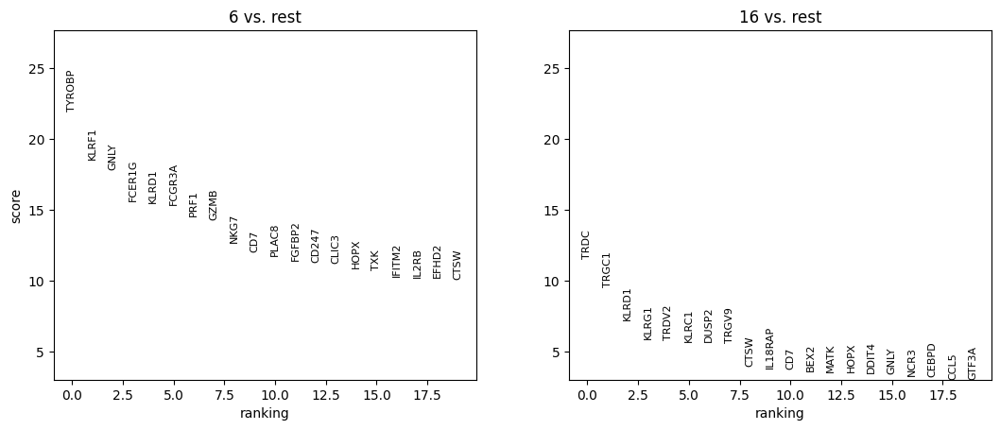

In [112]:
sc.tl.rank_genes_groups(
    adata, 
    groupby = 'leiden_2', 
    groups = ['6','16']
)
sc.pl.rank_genes_groups(adata, ncols = 2)

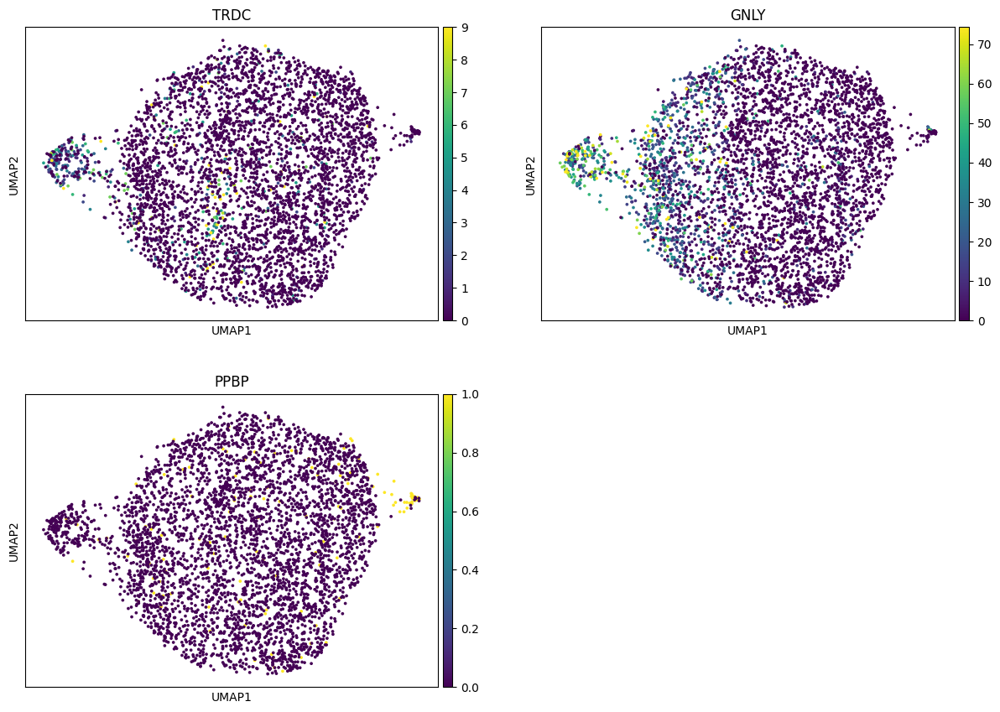

In [113]:
sc.pl.umap(adata, color = ['TRDC','GNLY','PPBP'], vmax = 'p99', ncols = 2)

### Comparison to original labels

In [114]:
adata = add_labels(adata, original_df)

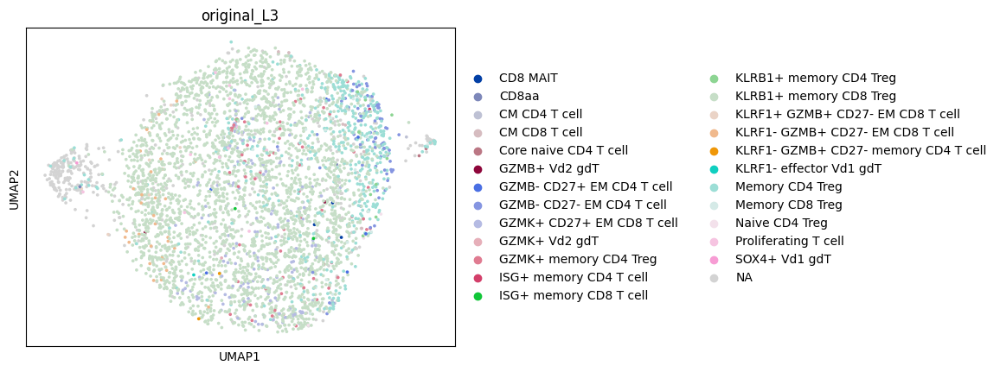

In [115]:
sc.pl.umap(adata, color = 'original_L3')

In [116]:
adata.obs['original_L3'].value_counts(dropna = False)

original_L3
KLRB1+ memory CD8 Treg                  2791
NaN                                      475
Memory CD4 Treg                          457
GZMK+ CD27+ EM CD8 T cell                166
GZMB- CD27- EM CD4 T cell                 81
GZMK+ memory CD4 Treg                     64
KLRF1- GZMB+ CD27- EM CD8 T cell          34
Memory CD8 Treg                           24
Proliferating T cell                      15
KLRB1+ memory CD4 Treg                    10
KLRF1+ GZMB+ CD27- EM CD8 T cell           9
CM CD8 T cell                              7
GZMB- CD27+ EM CD4 T cell                  6
CM CD4 T cell                              4
Naive CD4 Treg                             3
CD8 MAIT                                   3
CD8aa                                      3
ISG+ memory CD8 T cell                     3
KLRF1- GZMB+ CD27- memory CD4 T cell       2
GZMB+ Vd2 gdT                              2
Core naive CD4 T cell                      2
KLRF1- effector Vd1 gdT                    

In [117]:
adata.obs['original_L3'].value_counts(dropna = False) / adata.obs.shape[0]

original_L3
KLRB1+ memory CD8 Treg                  0.670108
NaN                                     0.114046
Memory CD4 Treg                         0.109724
GZMK+ CD27+ EM CD8 T cell               0.039856
GZMB- CD27- EM CD4 T cell               0.019448
GZMK+ memory CD4 Treg                   0.015366
KLRF1- GZMB+ CD27- EM CD8 T cell        0.008163
Memory CD8 Treg                         0.005762
Proliferating T cell                    0.003601
KLRB1+ memory CD4 Treg                  0.002401
KLRF1+ GZMB+ CD27- EM CD8 T cell        0.002161
CM CD8 T cell                           0.001681
GZMB- CD27+ EM CD4 T cell               0.001441
CM CD4 T cell                           0.000960
Naive CD4 Treg                          0.000720
CD8 MAIT                                0.000720
CD8aa                                   0.000720
ISG+ memory CD8 T cell                  0.000720
KLRF1- GZMB+ CD27- memory CD4 T cell    0.000480
GZMB+ Vd2 gdT                           0.000480
Core nai

### Proposed updates

- Remove GNLY-high cluster as mislabeled
- Remove PPBP-high cluster as Platelet doublets

## Review Memory CD4 Treg

In [118]:
cell_type = 'Memory CD4 Treg'
type_uuid = search_df['id'].loc[search_df['AIFI_L3'] == cell_type].tolist()[0]

In [119]:
type_uuid

'1f156144-c524-4e2c-a19b-a617badb5066'

In [120]:
adata = read_adata_uuid(type_uuid)

### Clustering

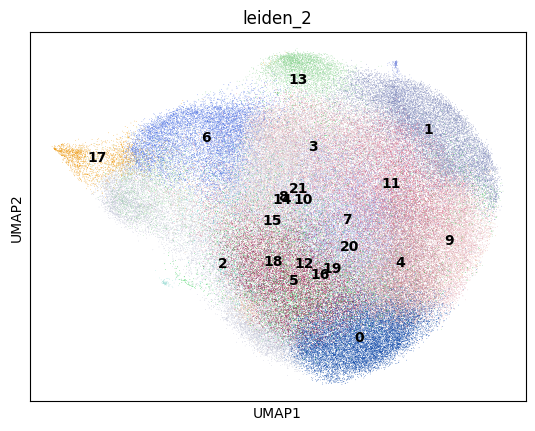

In [121]:
sc.pl.umap(adata, color = 'leiden_2', legend_loc = 'on data')

### Marker expression

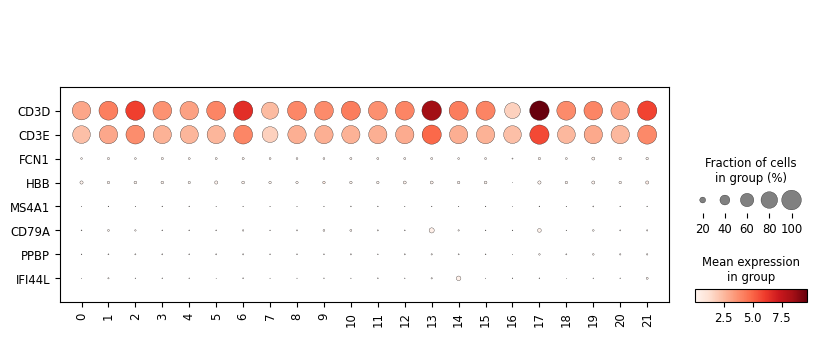

In [122]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = broad_markers, swap_axes = True)

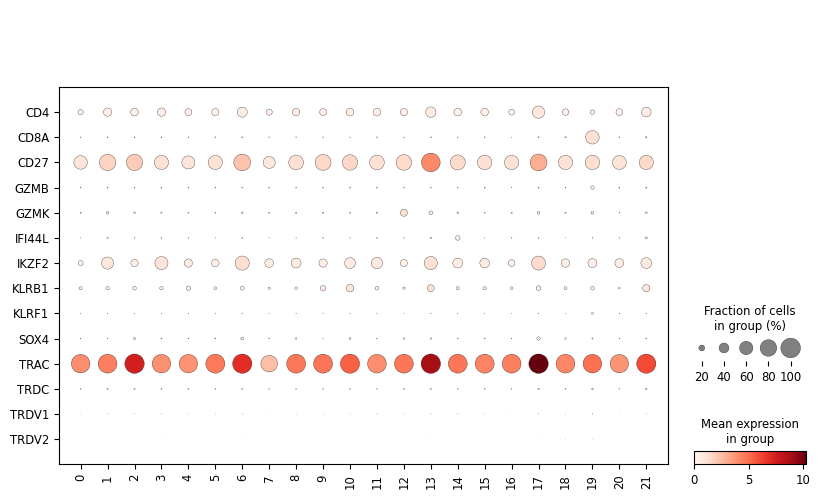

In [123]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = class_markers, swap_axes = True)

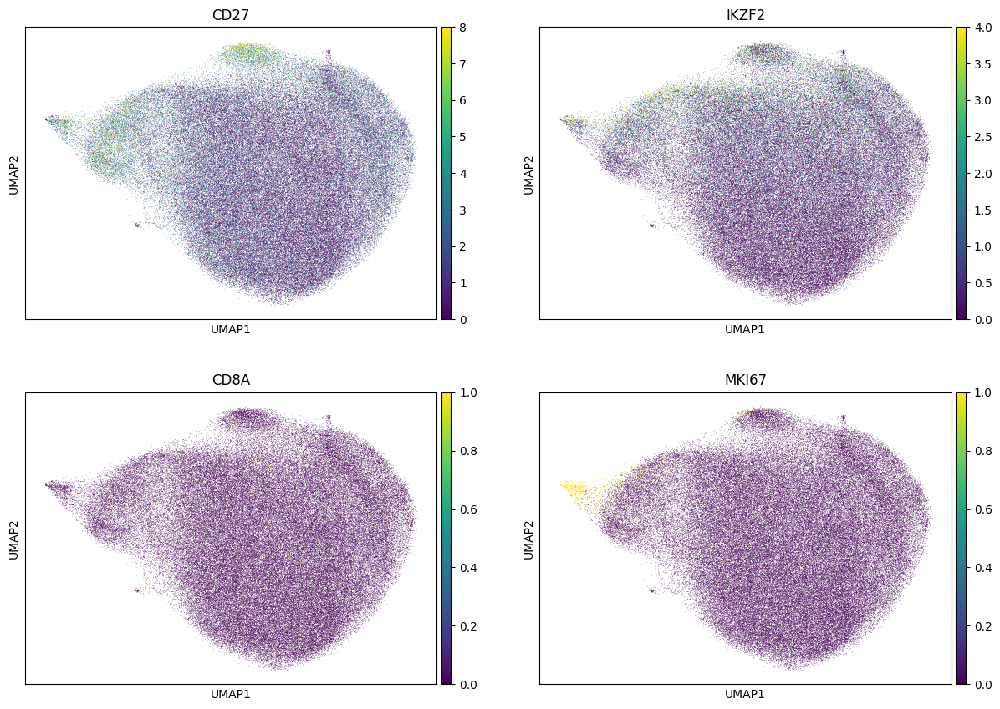

In [124]:
sc.pl.umap(adata, color = ['CD27','IKZF2','CD8A','MKI67'], vmax = 'p99', ncols = 2)

### Comparison to original labels

In [125]:
adata = add_labels(adata, original_df)

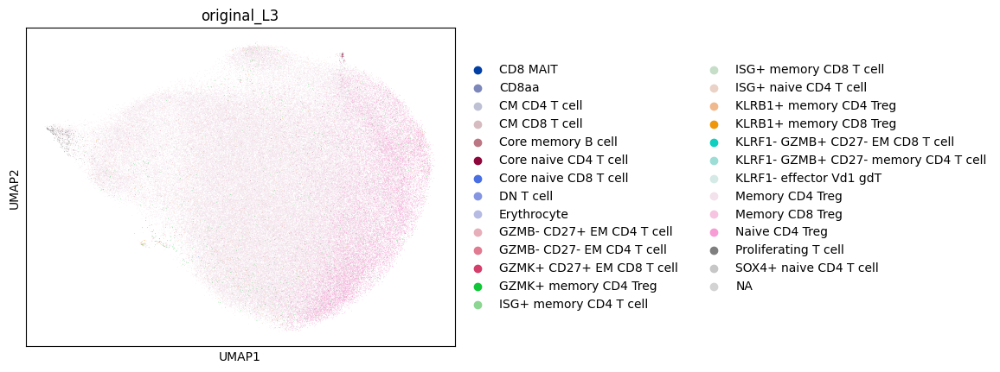

In [126]:
sc.pl.umap(adata, color = 'original_L3')

In [127]:
adata.obs['original_L3'].value_counts(dropna = False)

original_L3
Memory CD4 Treg                         119255
Naive CD4 Treg                           18095
CM CD4 T cell                             2141
KLRB1+ memory CD4 Treg                    1704
GZMK+ memory CD4 Treg                      892
NaN                                        849
GZMB- CD27- EM CD4 T cell                  803
Proliferating T cell                       327
Memory CD8 Treg                            284
Core naive CD4 T cell                      102
KLRB1+ memory CD8 Treg                      68
ISG+ memory CD4 T cell                      47
GZMK+ CD27+ EM CD8 T cell                   44
GZMB- CD27+ EM CD4 T cell                   21
Erythrocyte                                 11
CM CD8 T cell                                6
ISG+ naive CD4 T cell                        3
DN T cell                                    3
SOX4+ naive CD4 T cell                       3
ISG+ memory CD8 T cell                       2
CD8aa                                        1
K

In [128]:
adata.obs['original_L3'].value_counts(dropna = False) / adata.obs.shape[0]

original_L3
Memory CD4 Treg                         0.824341
Naive CD4 Treg                          0.125080
CM CD4 T cell                           0.014800
KLRB1+ memory CD4 Treg                  0.011779
GZMK+ memory CD4 Treg                   0.006166
NaN                                     0.005869
GZMB- CD27- EM CD4 T cell               0.005551
Proliferating T cell                    0.002260
Memory CD8 Treg                         0.001963
Core naive CD4 T cell                   0.000705
KLRB1+ memory CD8 Treg                  0.000470
ISG+ memory CD4 T cell                  0.000325
GZMK+ CD27+ EM CD8 T cell               0.000304
GZMB- CD27+ EM CD4 T cell               0.000145
Erythrocyte                             0.000076
CM CD8 T cell                           0.000041
ISG+ naive CD4 T cell                   0.000021
DN T cell                               0.000021
SOX4+ naive CD4 T cell                  0.000021
ISG+ memory CD8 T cell                  0.000014
CD8aa   

### Proposed updates

- Reassign MKI67-high cluster to Proliferating T cell

## Review Memory CD8 Treg

In [129]:
cell_type = 'Memory CD8 Treg'
type_uuid = search_df['id'].loc[search_df['AIFI_L3'] == cell_type].tolist()[0]

In [130]:
type_uuid

'ea9ebffc-0c0f-4ee4-b3ba-394585c5cca3'

In [131]:
adata = read_adata_uuid(type_uuid)

### Clustering

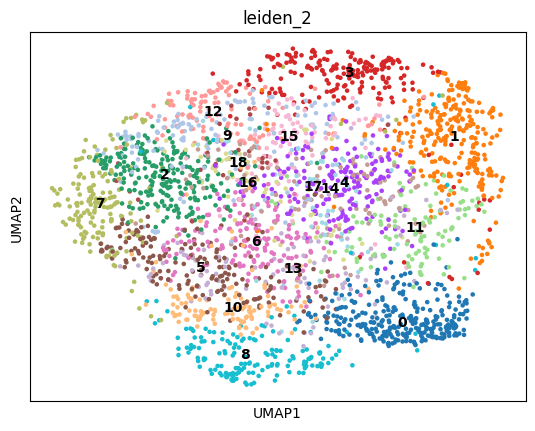

In [132]:
sc.pl.umap(adata, color = 'leiden_2', legend_loc = 'on data')

### Marker expression

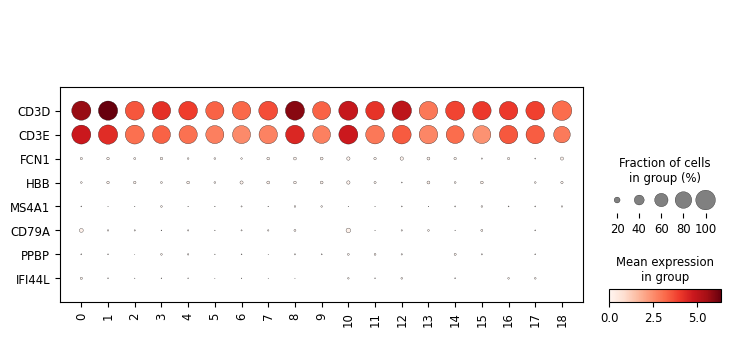

In [133]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = broad_markers, swap_axes = True)

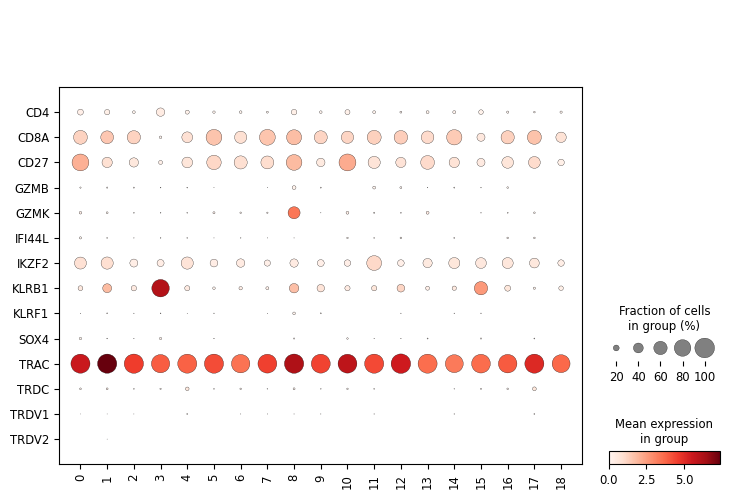

In [134]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = class_markers, swap_axes = True)

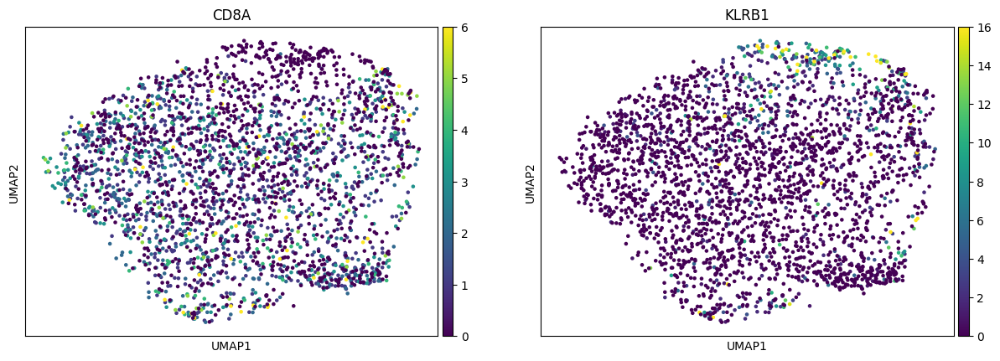

In [135]:
sc.pl.umap(adata, color = ['CD8A','KLRB1'], vmax = 'p99')

### Comparison to original labels

In [136]:
adata = add_labels(adata, original_df)

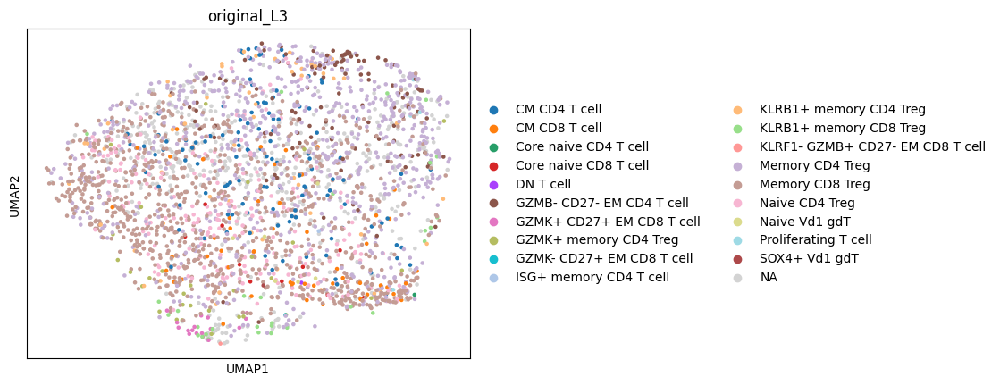

In [137]:
sc.pl.umap(adata, color = 'original_L3')

In [138]:
adata.obs['original_L3'].value_counts(dropna = False)

original_L3
Memory CD8 Treg                     904
Memory CD4 Treg                     699
NaN                                 517
Naive CD4 Treg                      214
CM CD4 T cell                       122
GZMB- CD27- EM CD4 T cell           115
KLRB1+ memory CD4 Treg               54
CM CD8 T cell                        52
GZMK+ memory CD4 Treg                30
KLRB1+ memory CD8 Treg               30
GZMK+ CD27+ EM CD8 T cell            17
Core naive CD8 T cell                10
Naive Vd1 gdT                         6
Proliferating T cell                  5
GZMK- CD27+ EM CD8 T cell             1
ISG+ memory CD4 T cell                1
KLRF1- GZMB+ CD27- EM CD8 T cell      1
DN T cell                             1
Core naive CD4 T cell                 1
SOX4+ Vd1 gdT                         1
Name: count, dtype: int64

In [139]:
adata.obs['original_L3'].value_counts(dropna = False) / adata.obs.shape[0]

original_L3
Memory CD8 Treg                     0.325063
Memory CD4 Treg                     0.251348
NaN                                 0.185904
Naive CD4 Treg                      0.076951
CM CD4 T cell                       0.043869
GZMB- CD27- EM CD4 T cell           0.041352
KLRB1+ memory CD4 Treg              0.019417
CM CD8 T cell                       0.018698
GZMK+ memory CD4 Treg               0.010787
KLRB1+ memory CD8 Treg              0.010787
GZMK+ CD27+ EM CD8 T cell           0.006113
Core naive CD8 T cell               0.003596
Naive Vd1 gdT                       0.002157
Proliferating T cell                0.001798
GZMK- CD27+ EM CD8 T cell           0.000360
ISG+ memory CD4 T cell              0.000360
KLRF1- GZMB+ CD27- EM CD8 T cell    0.000360
DN T cell                           0.000360
Core naive CD4 T cell               0.000360
SOX4+ Vd1 gdT                       0.000360
Name: count, dtype: float64

### Proposed updates

No proposed changes

## Review Naive CD4 Treg

In [140]:
cell_type = 'Naive CD4 Treg'
type_uuid = search_df['id'].loc[search_df['AIFI_L3'] == cell_type].tolist()[0]

In [141]:
type_uuid

'bd426270-cde3-4ae3-8a80-1b10d7738b0a'

In [142]:
adata = read_adata_uuid(type_uuid)

### Clustering

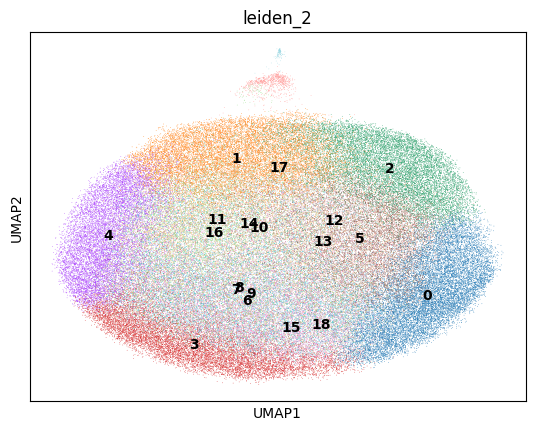

In [143]:
sc.pl.umap(adata, color = 'leiden_2', legend_loc = 'on data')

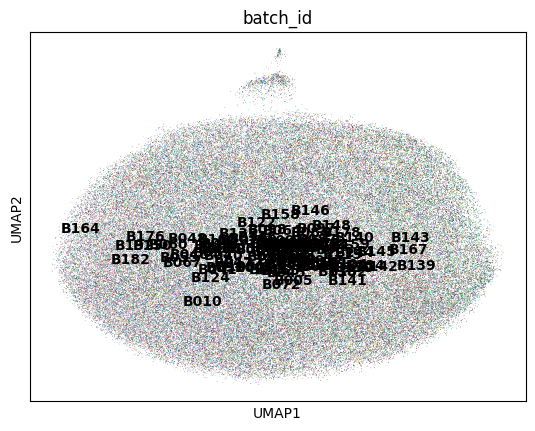

In [144]:
sc.pl.umap(adata, color = 'batch_id', legend_loc = 'on data')

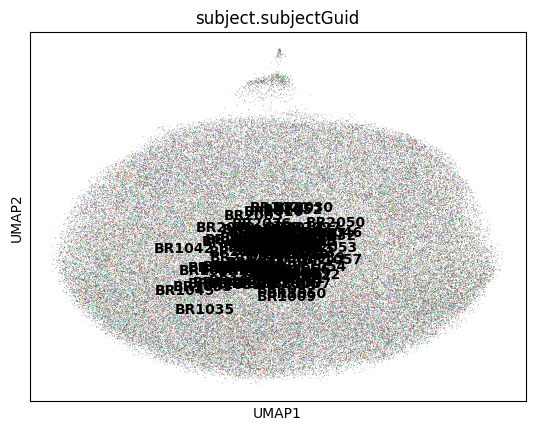

In [145]:
sc.pl.umap(adata, color = 'subject.subjectGuid', legend_loc = 'on data')

### Marker expression

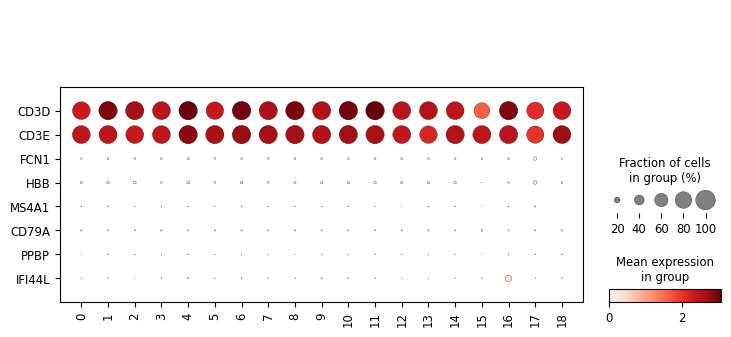

In [146]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = broad_markers, swap_axes = True)

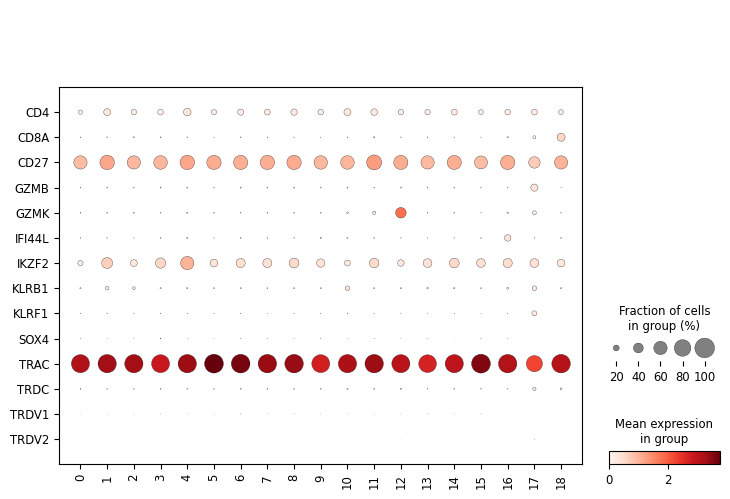

In [147]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = class_markers, swap_axes = True)

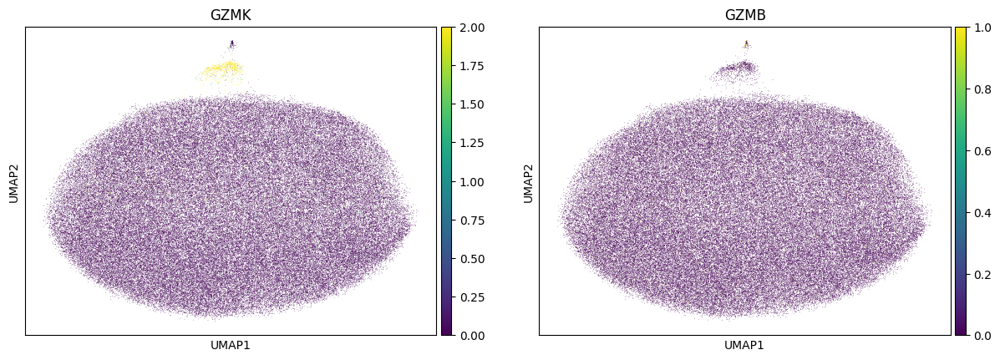

In [148]:
sc.pl.umap(adata, color = ['GZMK','GZMB'], vmax = 'p99')

### Comparison to original labels

In [149]:
adata = add_labels(adata, original_df)

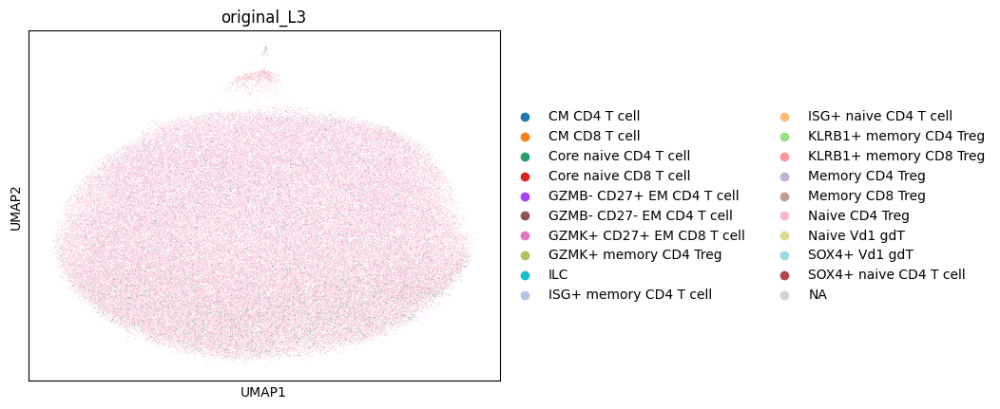

In [150]:
sc.pl.umap(adata, color = 'original_L3')

In [151]:
adata.obs['original_L3'].value_counts(dropna = False)

original_L3
Naive CD4 Treg               118741
Core naive CD4 T cell          3495
Memory CD4 Treg                2373
CM CD4 T cell                  1426
NaN                             621
Memory CD8 Treg                 111
GZMK+ memory CD4 Treg           110
KLRB1+ memory CD4 Treg           84
CM CD8 T cell                    43
ISG+ naive CD4 T cell            40
Core naive CD8 T cell            34
Naive Vd1 gdT                    33
SOX4+ naive CD4 T cell           22
GZMB- CD27+ EM CD4 T cell        17
GZMB- CD27- EM CD4 T cell        16
GZMK+ CD27+ EM CD8 T cell         9
ISG+ memory CD4 T cell            7
KLRB1+ memory CD8 Treg            5
SOX4+ Vd1 gdT                     3
ILC                               1
Name: count, dtype: int64

In [152]:
adata.obs['original_L3'].value_counts(dropna = False) / adata.obs.shape[0]

original_L3
Naive CD4 Treg               0.933564
Core naive CD4 T cell        0.027478
Memory CD4 Treg              0.018657
CM CD4 T cell                0.011211
NaN                          0.004882
Memory CD8 Treg              0.000873
GZMK+ memory CD4 Treg        0.000865
KLRB1+ memory CD4 Treg       0.000660
CM CD8 T cell                0.000338
ISG+ naive CD4 T cell        0.000314
Core naive CD8 T cell        0.000267
Naive Vd1 gdT                0.000259
SOX4+ naive CD4 T cell       0.000173
GZMB- CD27+ EM CD4 T cell    0.000134
GZMB- CD27- EM CD4 T cell    0.000126
GZMK+ CD27+ EM CD8 T cell    0.000071
ISG+ memory CD4 T cell       0.000055
KLRB1+ memory CD8 Treg       0.000039
SOX4+ Vd1 gdT                0.000024
ILC                          0.000008
Name: count, dtype: float64

### Proposed updates

- Remove GZMK-high cells as mislabled?

# Vd1 gdT

## Review KLRF1- effector Vd1 gdT

In [153]:
cell_type = 'KLRF1- effector Vd1 gdT'
type_uuid = search_df['id'].loc[search_df['AIFI_L3'] == cell_type].tolist()[0]

In [154]:
type_uuid

'944d847c-1281-46ce-8d9e-512fe0a8830e'

In [155]:
adata = read_adata_uuid(type_uuid)

### Clustering

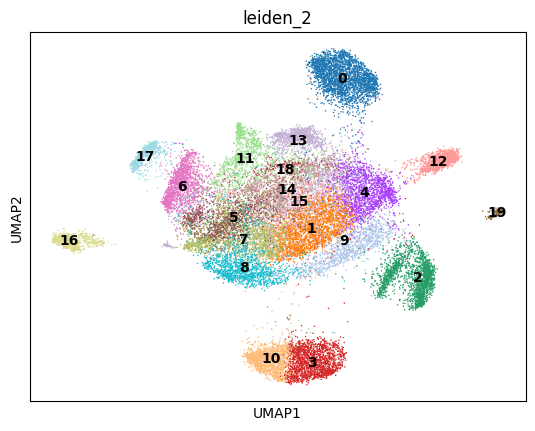

In [156]:
sc.pl.umap(adata, color = 'leiden_2', legend_loc = 'on data')

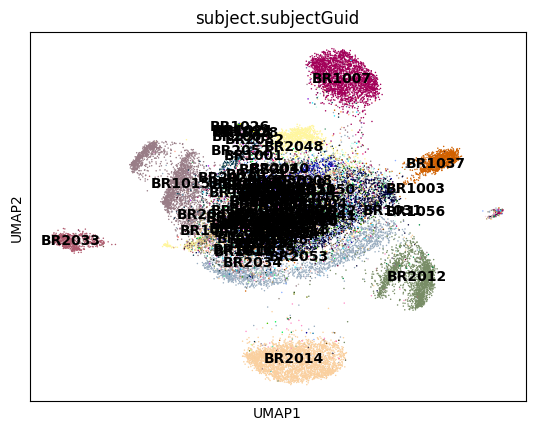

In [157]:
sc.pl.umap(adata, color = 'subject.subjectGuid', legend_loc = 'on data')

### Marker expression

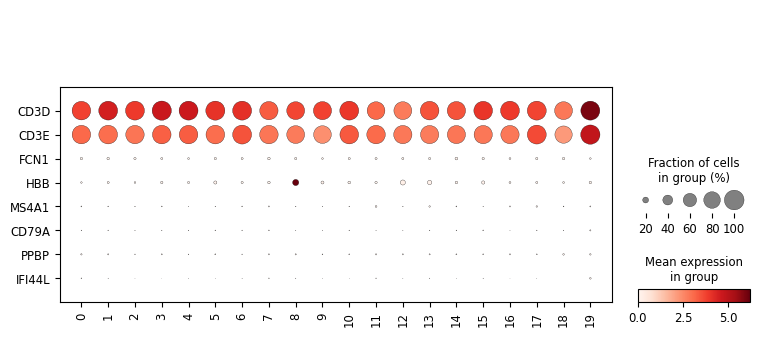

In [158]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = broad_markers, swap_axes = True)

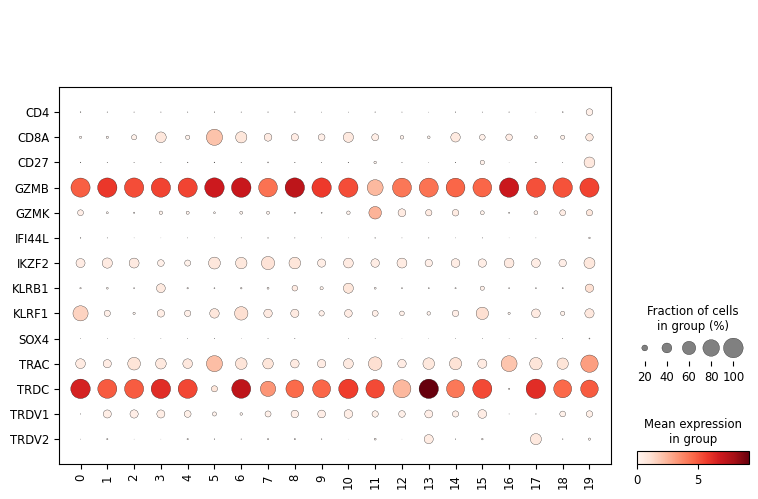

In [159]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = class_markers, swap_axes = True)

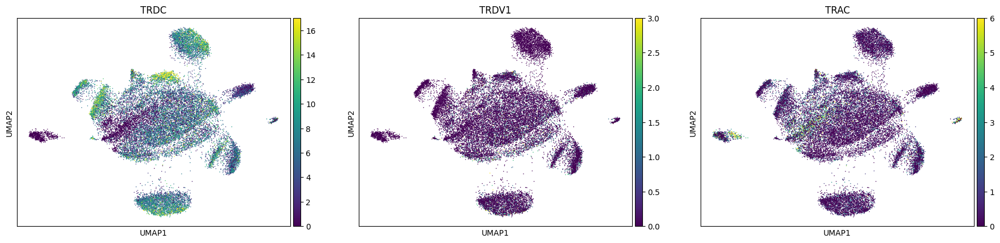

In [160]:
sc.pl.umap(adata, color = ['TRDC','TRDV1','TRAC'], vmax = 'p99')

### Comparison to original labels

In [161]:
adata = add_labels(adata, original_df)

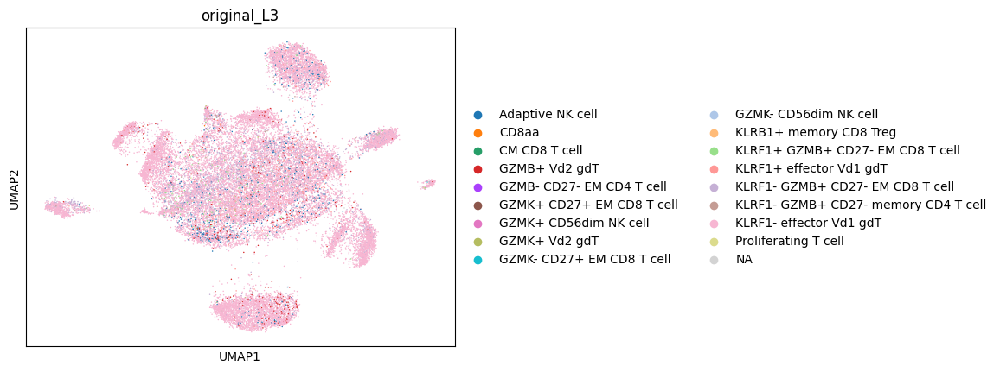

In [162]:
sc.pl.umap(adata, color = 'original_L3')

In [163]:
adata.obs['original_L3'].value_counts(dropna = False)

original_L3
KLRF1- effector Vd1 gdT                 21326
KLRF1- GZMB+ CD27- EM CD8 T cell         2614
Adaptive NK cell                          898
KLRF1+ effector Vd1 gdT                   569
GZMB+ Vd2 gdT                             408
KLRF1+ GZMB+ CD27- EM CD8 T cell          274
NaN                                       194
KLRF1- GZMB+ CD27- memory CD4 T cell       56
CD8aa                                      11
GZMK- CD56dim NK cell                      10
GZMK+ Vd2 gdT                               7
Proliferating T cell                        6
GZMK+ CD27+ EM CD8 T cell                   5
GZMB- CD27- EM CD4 T cell                   4
GZMK+ CD56dim NK cell                       2
GZMK- CD27+ EM CD8 T cell                   1
KLRB1+ memory CD8 Treg                      1
CM CD8 T cell                               1
Name: count, dtype: int64

In [164]:
adata.obs['original_L3'].value_counts(dropna = False) / adata.obs.shape[0]

original_L3
KLRF1- effector Vd1 gdT                 0.808201
KLRF1- GZMB+ CD27- EM CD8 T cell        0.099064
Adaptive NK cell                        0.034032
KLRF1+ effector Vd1 gdT                 0.021564
GZMB+ Vd2 gdT                           0.015462
KLRF1+ GZMB+ CD27- EM CD8 T cell        0.010384
NaN                                     0.007352
KLRF1- GZMB+ CD27- memory CD4 T cell    0.002122
CD8aa                                   0.000417
GZMK- CD56dim NK cell                   0.000379
GZMK+ Vd2 gdT                           0.000265
Proliferating T cell                    0.000227
GZMK+ CD27+ EM CD8 T cell               0.000189
GZMB- CD27- EM CD4 T cell               0.000152
GZMK+ CD56dim NK cell                   0.000076
GZMK- CD27+ EM CD8 T cell               0.000038
KLRB1+ memory CD8 Treg                  0.000038
CM CD8 T cell                           0.000038
Name: count, dtype: float64

### Proposed updates

No proposed changes

## Review KLRF1+ effector Vd1 gdT

In [165]:
cell_type = 'KLRF1+ effector Vd1 gdT'
type_uuid = search_df['id'].loc[search_df['AIFI_L3'] == cell_type].tolist()[0]

In [166]:
type_uuid

'cb68fc02-5b01-47b8-9c36-d4c0269ee490'

In [167]:
adata = read_adata_uuid(type_uuid)

### Clustering

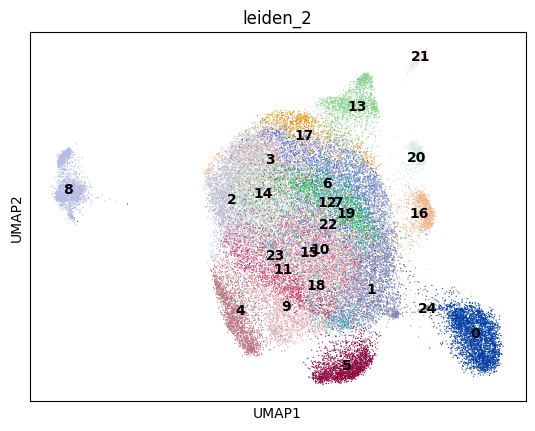

In [168]:
sc.pl.umap(adata, color = 'leiden_2', legend_loc = 'on data')

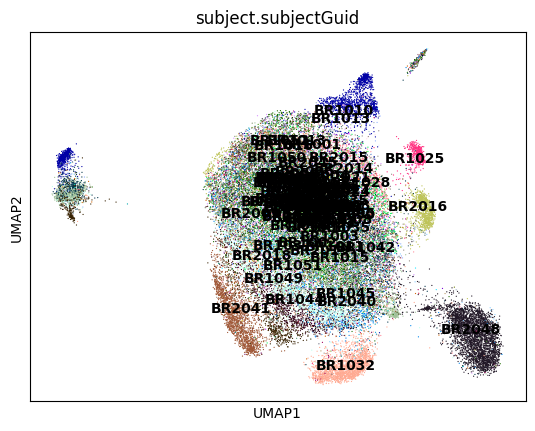

In [169]:
sc.pl.umap(adata, color = 'subject.subjectGuid', legend_loc = 'on data')

### Marker expression

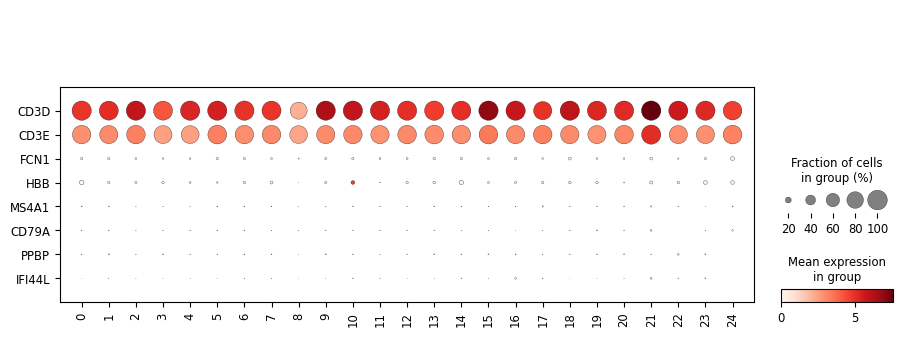

In [170]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = broad_markers, swap_axes = True)

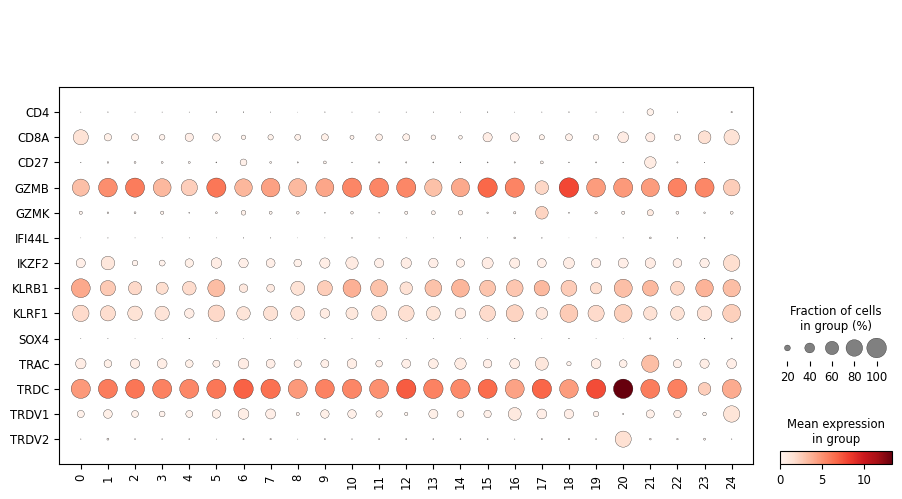

In [171]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = class_markers, swap_axes = True)

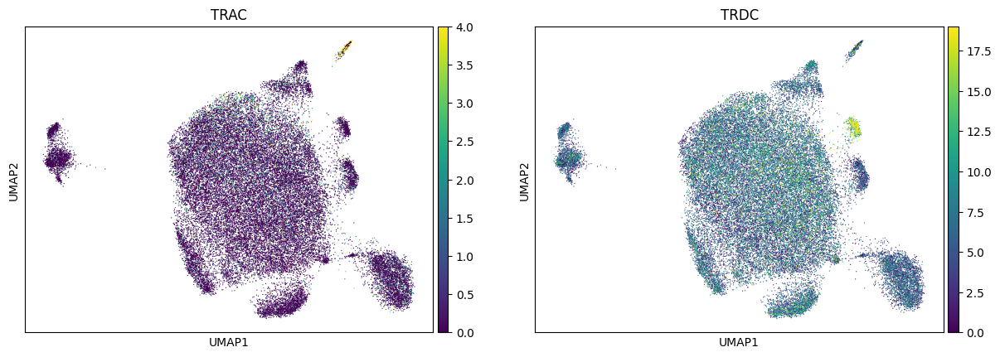

In [172]:
sc.pl.umap(adata, color = ['TRAC','TRDC'], vmax = 'p99')

### Comparison to original labels

In [173]:
adata = add_labels(adata, original_df)

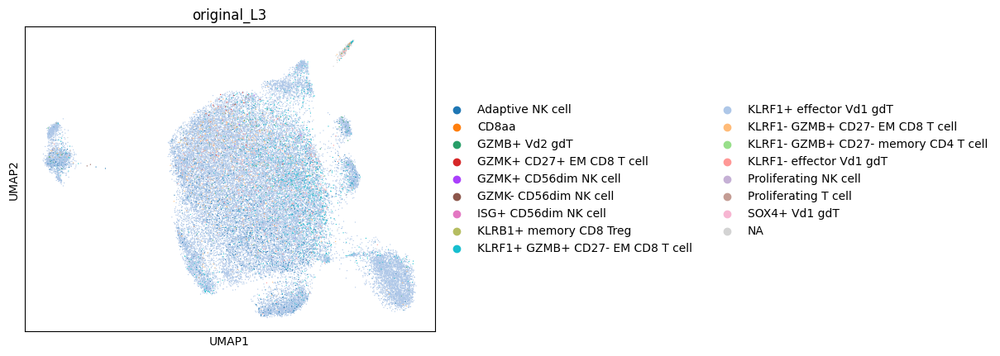

In [174]:
sc.pl.umap(adata, color = 'original_L3')

In [175]:
adata.obs['original_L3'].value_counts(dropna = False)

original_L3
KLRF1+ effector Vd1 gdT                 33168
KLRF1+ GZMB+ CD27- EM CD8 T cell         1756
Adaptive NK cell                         1398
KLRF1- GZMB+ CD27- EM CD8 T cell          697
NaN                                       682
KLRF1- effector Vd1 gdT                   555
GZMB+ Vd2 gdT                             177
GZMK+ CD27+ EM CD8 T cell                  38
GZMK- CD56dim NK cell                      11
GZMK+ CD56dim NK cell                       6
Proliferating T cell                        4
KLRF1- GZMB+ CD27- memory CD4 T cell        3
ISG+ CD56dim NK cell                        2
KLRB1+ memory CD8 Treg                      2
Proliferating NK cell                       2
CD8aa                                       1
SOX4+ Vd1 gdT                               1
Name: count, dtype: int64

In [176]:
adata.obs['original_L3'].value_counts(dropna = False) / adata.obs.shape[0]

original_L3
KLRF1+ effector Vd1 gdT                 0.861439
KLRF1+ GZMB+ CD27- EM CD8 T cell        0.045607
Adaptive NK cell                        0.036309
KLRF1- GZMB+ CD27- EM CD8 T cell        0.018102
NaN                                     0.017713
KLRF1- effector Vd1 gdT                 0.014414
GZMB+ Vd2 gdT                           0.004597
GZMK+ CD27+ EM CD8 T cell               0.000987
GZMK- CD56dim NK cell                   0.000286
GZMK+ CD56dim NK cell                   0.000156
Proliferating T cell                    0.000104
KLRF1- GZMB+ CD27- memory CD4 T cell    0.000078
ISG+ CD56dim NK cell                    0.000052
KLRB1+ memory CD8 Treg                  0.000052
Proliferating NK cell                   0.000052
CD8aa                                   0.000026
SOX4+ Vd1 gdT                           0.000026
Name: count, dtype: float64

### Proposed updates

No proposed changes

## Review Naive Vd1 gdT

In [177]:
cell_type = 'Naive Vd1 gdT'
type_uuid = search_df['id'].loc[search_df['AIFI_L3'] == cell_type].tolist()[0]

In [178]:
type_uuid

'8499232d-e5fe-4292-919a-6cba21d260bd'

In [179]:
adata = read_adata_uuid(type_uuid)

### Clustering

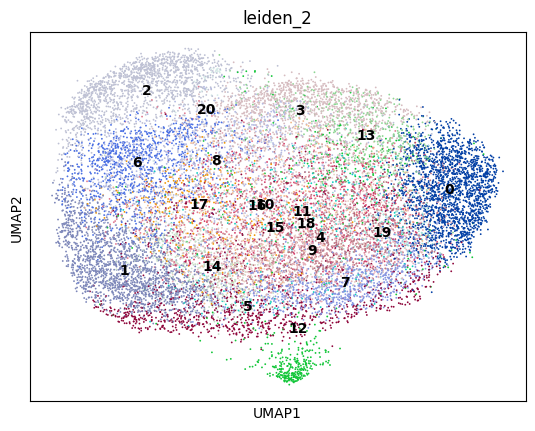

In [180]:
sc.pl.umap(adata, color = 'leiden_2', legend_loc = 'on data')

### Marker expression

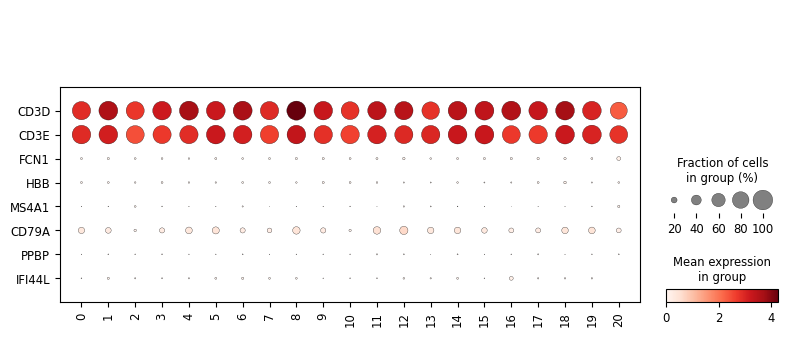

In [181]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = broad_markers, swap_axes = True)

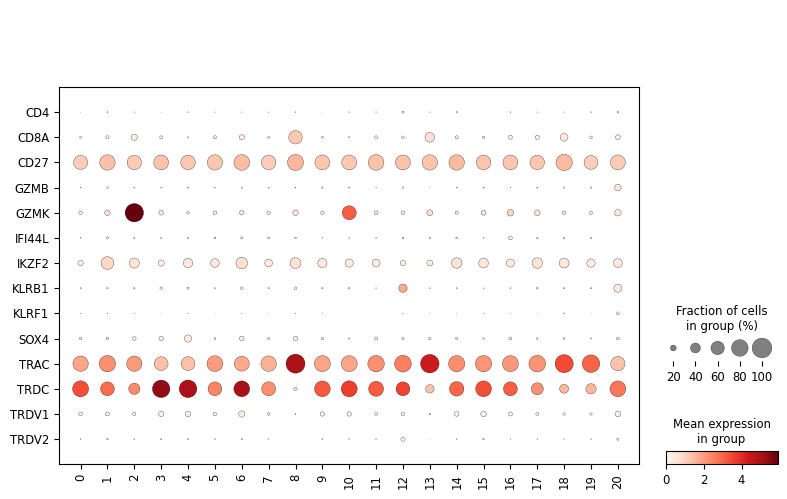

In [182]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = class_markers, swap_axes = True)

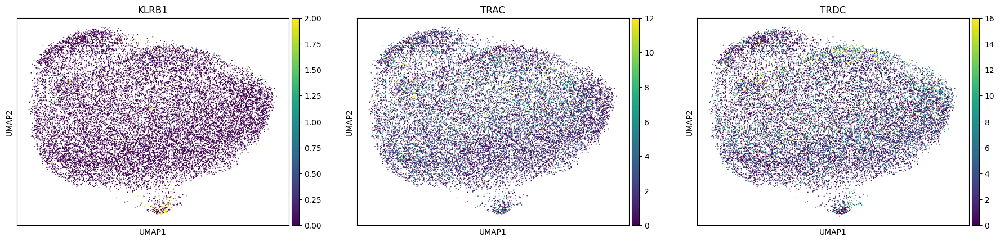

In [183]:
sc.pl.umap(adata, color = ['KLRB1','TRAC','TRDC'], vmax = 'p99')

### Comparison to original labels

In [184]:
adata = add_labels(adata, original_df)

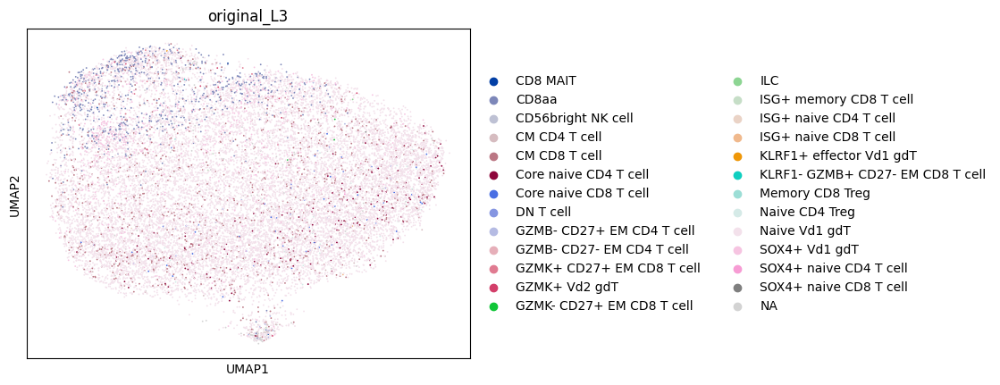

In [185]:
sc.pl.umap(adata, color = 'original_L3')

In [186]:
adata.obs['original_L3'].value_counts(dropna = False)

original_L3
Naive Vd1 gdT                       14471
CM CD8 T cell                        1051
SOX4+ Vd1 gdT                         698
CD8aa                                 676
NaN                                   254
Core naive CD4 T cell                 203
Core naive CD8 T cell                  66
CM CD4 T cell                          55
Naive CD4 Treg                         47
GZMB- CD27+ EM CD4 T cell              15
GZMK+ CD27+ EM CD8 T cell              15
GZMK+ Vd2 gdT                          14
ISG+ naive CD4 T cell                   8
SOX4+ naive CD8 T cell                  3
SOX4+ naive CD4 T cell                  3
CD8 MAIT                                3
GZMK- CD27+ EM CD8 T cell               3
GZMB- CD27- EM CD4 T cell               3
DN T cell                               3
ISG+ naive CD8 T cell                   2
Memory CD8 Treg                         2
ISG+ memory CD8 T cell                  2
ILC                                     2
KLRF1+ effector Vd1 gd

In [187]:
adata.obs['original_L3'].value_counts(dropna = False) / adata.obs.shape[0]

original_L3
Naive Vd1 gdT                       0.822122
CM CD8 T cell                       0.059709
SOX4+ Vd1 gdT                       0.039655
CD8aa                               0.038405
NaN                                 0.014430
Core naive CD4 T cell               0.011533
Core naive CD8 T cell               0.003750
CM CD4 T cell                       0.003125
Naive CD4 Treg                      0.002670
GZMB- CD27+ EM CD4 T cell           0.000852
GZMK+ CD27+ EM CD8 T cell           0.000852
GZMK+ Vd2 gdT                       0.000795
ISG+ naive CD4 T cell               0.000454
SOX4+ naive CD8 T cell              0.000170
SOX4+ naive CD4 T cell              0.000170
CD8 MAIT                            0.000170
GZMK- CD27+ EM CD8 T cell           0.000170
GZMB- CD27- EM CD4 T cell           0.000170
DN T cell                           0.000170
ISG+ naive CD8 T cell               0.000114
Memory CD8 Treg                     0.000114
ISG+ memory CD8 T cell              0.00011

### Proposed updates

- Remove KLRB1+ cluster as Mislabeled

## Review SOX4+ Vd1 gdT

In [188]:
cell_type = 'SOX4+ Vd1 gdT'
type_uuid = search_df['id'].loc[search_df['AIFI_L3'] == cell_type].tolist()[0]

In [189]:
type_uuid

'5363c178-9783-48cd-9d74-30fec4cbc6f4'

In [190]:
adata = read_adata_uuid(type_uuid)

### Clustering

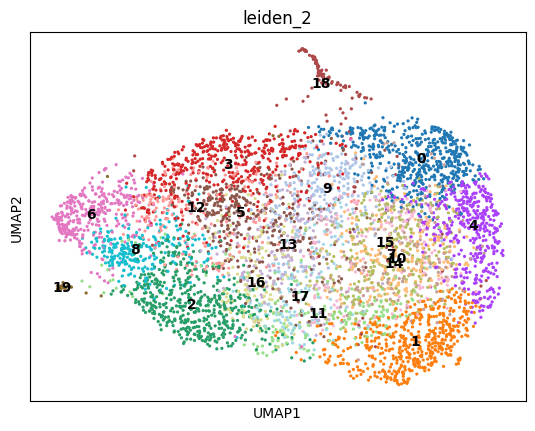

In [191]:
sc.pl.umap(adata, color = 'leiden_2', legend_loc = 'on data')

### Marker expression

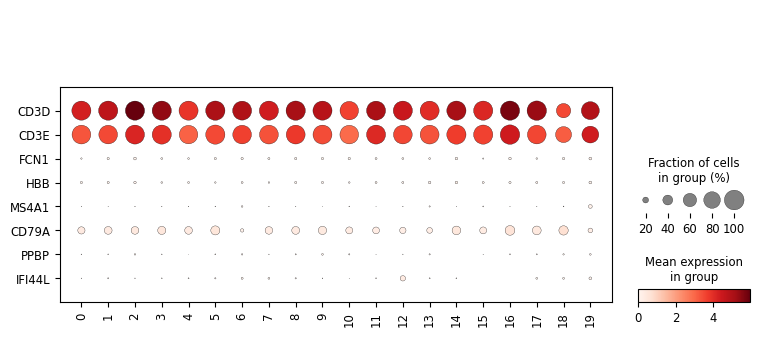

In [192]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = broad_markers, swap_axes = True)

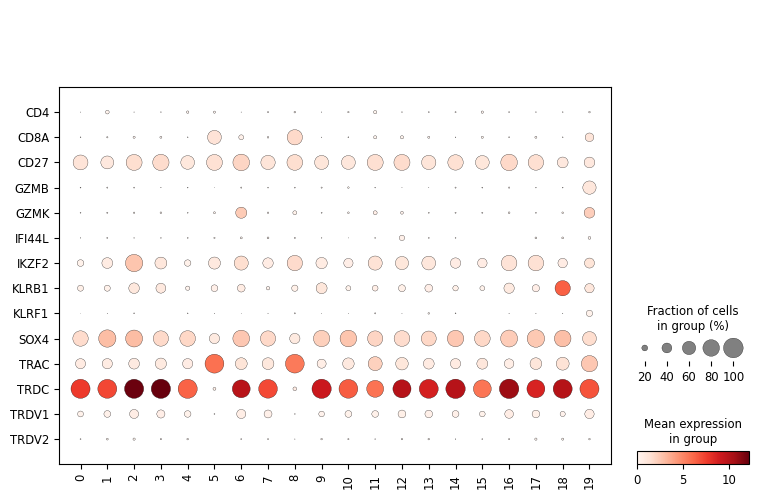

In [193]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = class_markers, swap_axes = True)

### Outlier investigation

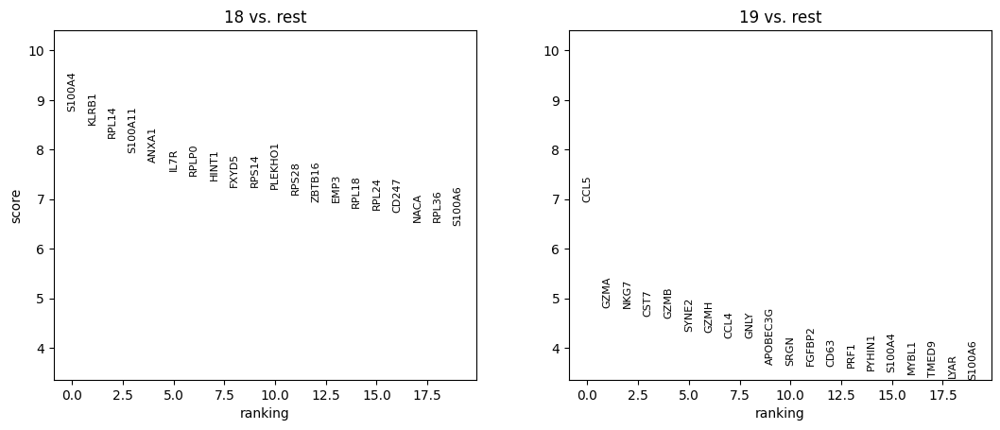

In [194]:
sc.tl.rank_genes_groups(
    adata, 
    groupby = 'leiden_2', 
    groups = ['18','19']
)
sc.pl.rank_genes_groups(adata, ncols = 2)

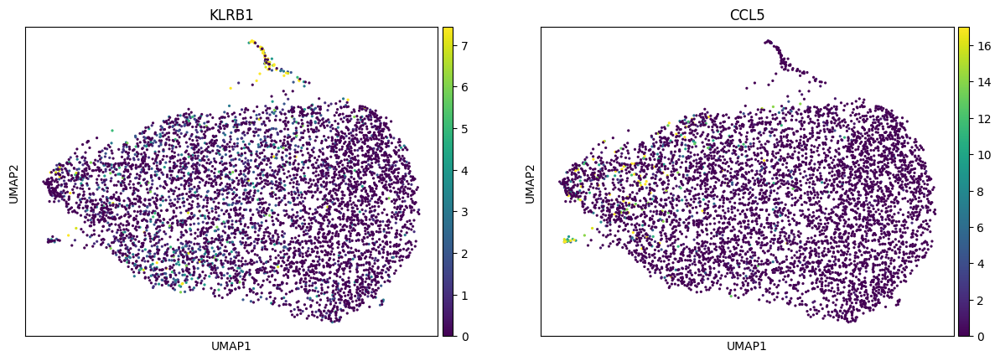

In [195]:
sc.pl.umap(adata, color = ['KLRB1','CCL5'], vmax = 'p99')

### Comparison to original labels

In [196]:
adata = add_labels(adata, original_df)

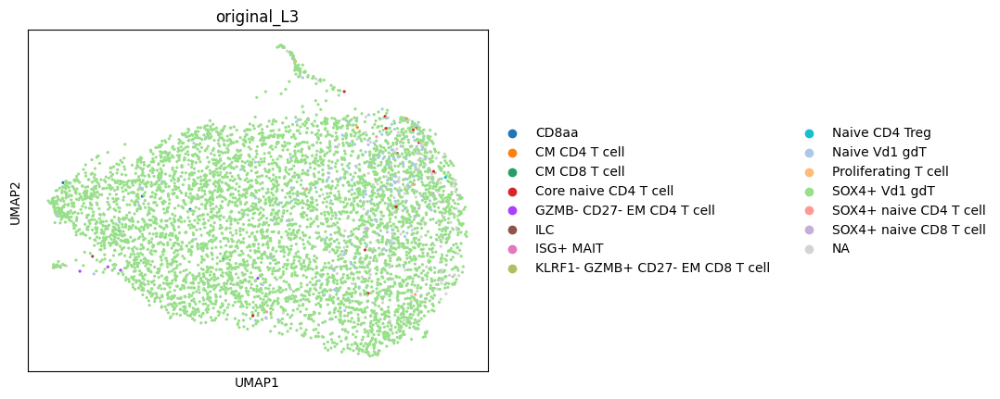

In [197]:
sc.pl.umap(adata, color = 'original_L3')

In [198]:
adata.obs['original_L3'].value_counts(dropna = False)

original_L3
SOX4+ Vd1 gdT                       5096
NaN                                  245
Naive Vd1 gdT                        173
Core naive CD4 T cell                 13
SOX4+ naive CD4 T cell                 6
SOX4+ naive CD8 T cell                 5
CD8aa                                  4
GZMB- CD27- EM CD4 T cell              4
CM CD4 T cell                          3
ILC                                    3
CM CD8 T cell                          1
ISG+ MAIT                              1
KLRF1- GZMB+ CD27- EM CD8 T cell       1
Naive CD4 Treg                         1
Proliferating T cell                   1
Name: count, dtype: int64

In [199]:
adata.obs['original_L3'].value_counts(dropna = False) / adata.obs.shape[0]

original_L3
SOX4+ Vd1 gdT                       0.917042
NaN                                 0.044089
Naive Vd1 gdT                       0.031132
Core naive CD4 T cell               0.002339
SOX4+ naive CD4 T cell              0.001080
SOX4+ naive CD8 T cell              0.000900
CD8aa                               0.000720
GZMB- CD27- EM CD4 T cell           0.000720
CM CD4 T cell                       0.000540
ILC                                 0.000540
CM CD8 T cell                       0.000180
ISG+ MAIT                           0.000180
KLRF1- GZMB+ CD27- EM CD8 T cell    0.000180
Naive CD4 Treg                      0.000180
Proliferating T cell                0.000180
Name: count, dtype: float64

### Proposed updates

- Remove KLRB1+ cluster as Mislabeled

# Vd2 gdT

## Review GZMB+ Vd2 gdT

In [200]:
cell_type = 'GZMB+ Vd2 gdT'
type_uuid = search_df['id'].loc[search_df['AIFI_L3'] == cell_type].tolist()[0]

In [201]:
type_uuid

'75152e09-ada0-47f3-bfe4-eddf1475815f'

In [202]:
adata = read_adata_uuid(type_uuid)

### Clustering

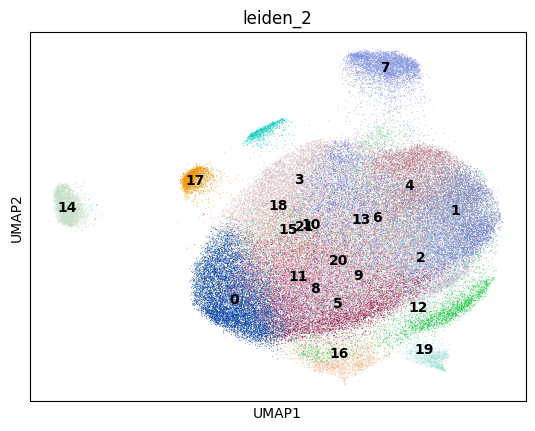

In [203]:
sc.pl.umap(adata, color = 'leiden_2', legend_loc = 'on data')

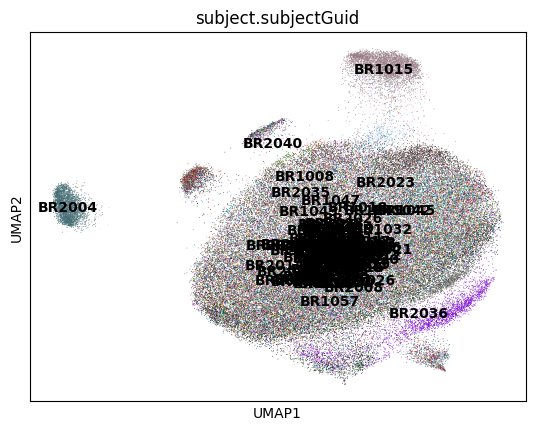

In [204]:
sc.pl.umap(adata, color = 'subject.subjectGuid', legend_loc = 'on data')

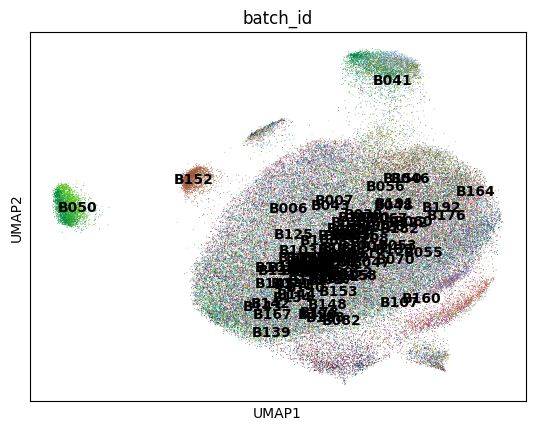

In [205]:
sc.pl.umap(adata, color = 'batch_id', legend_loc = 'on data')

### Marker expression

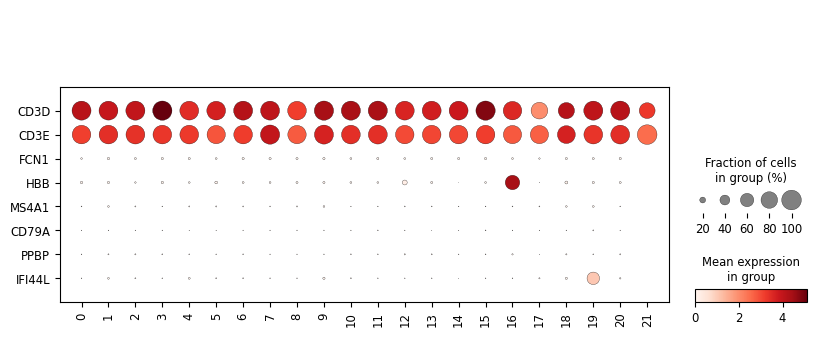

In [206]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = broad_markers, swap_axes = True)

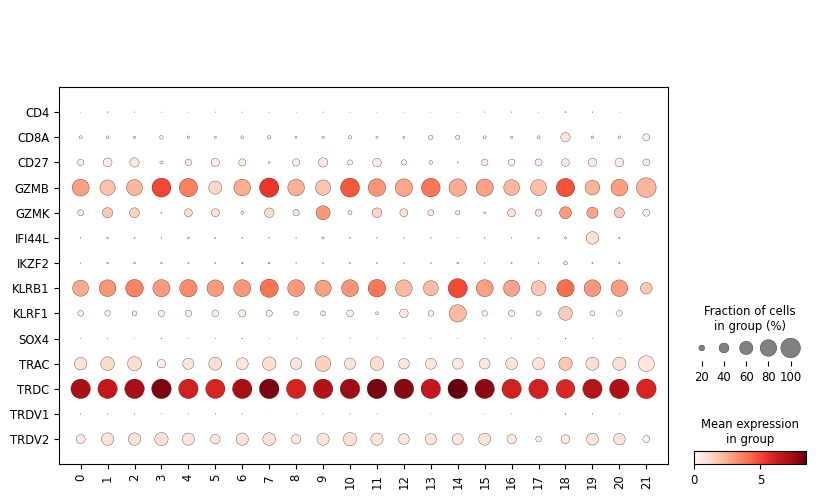

In [207]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = class_markers, swap_axes = True)

### Outlier investigation

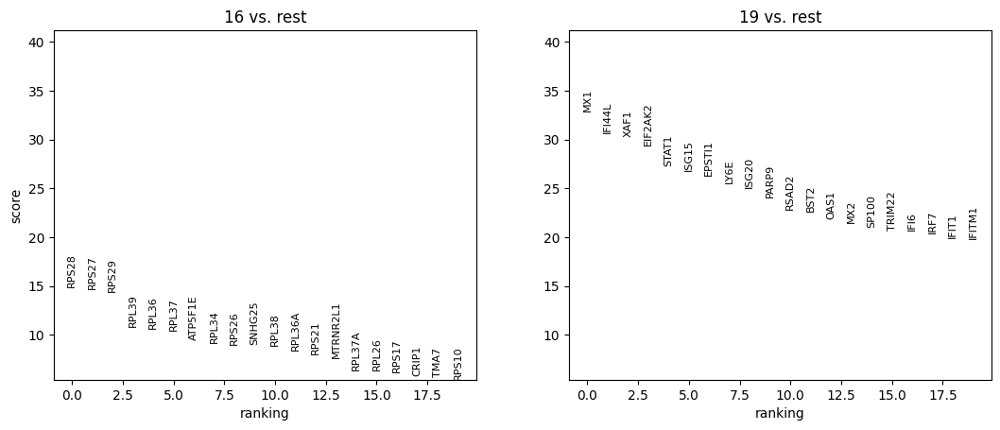

In [208]:
sc.tl.rank_genes_groups(
    adata, 
    groupby = 'leiden_2', 
    groups = ['16','19']
)
sc.pl.rank_genes_groups(adata, ncols = 2)

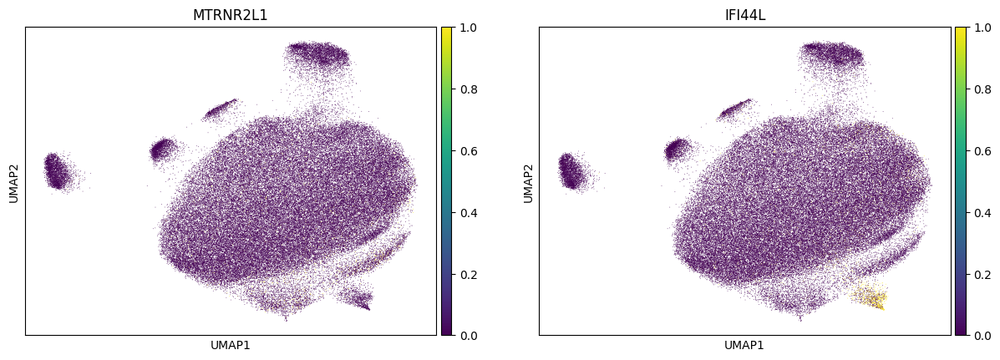

In [209]:
sc.pl.umap(adata, color = ['MTRNR2L1','IFI44L'], vmax = 'p99')

### Comparison to original labels

In [210]:
adata = add_labels(adata, original_df)

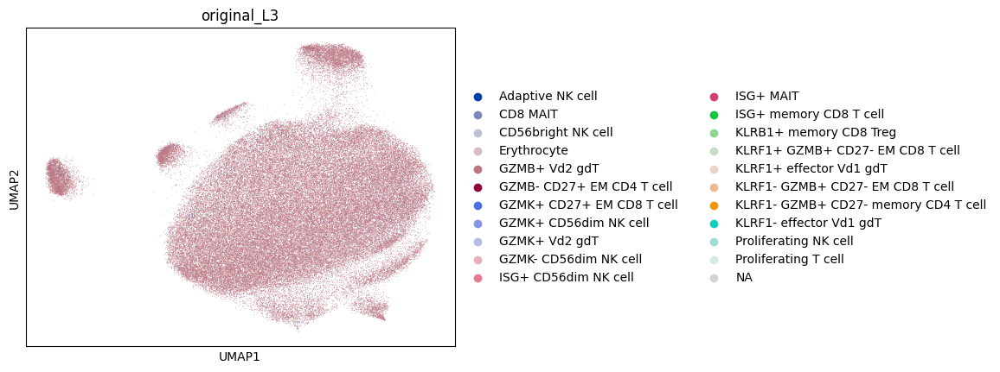

In [211]:
sc.pl.umap(adata, color = 'original_L3')

In [212]:
adata.obs['original_L3'].value_counts(dropna = False)

original_L3
GZMB+ Vd2 gdT                           90017
GZMK+ Vd2 gdT                            1734
KLRF1- GZMB+ CD27- EM CD8 T cell          543
NaN                                       491
Adaptive NK cell                          420
KLRF1- effector Vd1 gdT                   274
KLRF1+ effector Vd1 gdT                   240
GZMK- CD56dim NK cell                     106
KLRF1+ GZMB+ CD27- EM CD8 T cell           90
KLRF1- GZMB+ CD27- memory CD4 T cell       60
GZMK+ CD56dim NK cell                      44
GZMK+ CD27+ EM CD8 T cell                  13
ISG+ CD56dim NK cell                       10
ISG+ MAIT                                   8
Proliferating T cell                        7
CD56bright NK cell                          6
Proliferating NK cell                       5
ISG+ memory CD8 T cell                      4
Erythrocyte                                 3
CD8 MAIT                                    3
GZMB- CD27+ EM CD4 T cell                   1
KLRB1+ memory CD8 Treg

In [213]:
adata.obs['original_L3'].value_counts(dropna = False) / adata.obs.shape[0]

original_L3
GZMB+ Vd2 gdT                           0.956813
GZMK+ Vd2 gdT                           0.018431
KLRF1- GZMB+ CD27- EM CD8 T cell        0.005772
NaN                                     0.005219
Adaptive NK cell                        0.004464
KLRF1- effector Vd1 gdT                 0.002912
KLRF1+ effector Vd1 gdT                 0.002551
GZMK- CD56dim NK cell                   0.001127
KLRF1+ GZMB+ CD27- EM CD8 T cell        0.000957
KLRF1- GZMB+ CD27- memory CD4 T cell    0.000638
GZMK+ CD56dim NK cell                   0.000468
GZMK+ CD27+ EM CD8 T cell               0.000138
ISG+ CD56dim NK cell                    0.000106
ISG+ MAIT                               0.000085
Proliferating T cell                    0.000074
CD56bright NK cell                      0.000064
Proliferating NK cell                   0.000053
ISG+ memory CD8 T cell                  0.000043
Erythrocyte                             0.000032
CD8 MAIT                                0.000032
GZMB- CD

### Proposed updates

- Remove or relabel IFI44L-high cluster as ISG-high

## Review GZMK+ Vd2 gdT

In [214]:
cell_type = 'GZMK+ Vd2 gdT'
type_uuid = search_df['id'].loc[search_df['AIFI_L3'] == cell_type].tolist()[0]

In [215]:
type_uuid

'bd5f74a9-8269-4fdd-b59e-6231133e10ab'

In [216]:
adata = read_adata_uuid(type_uuid)

### Clustering

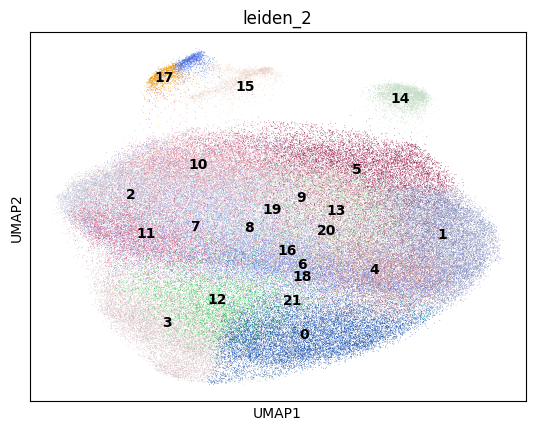

In [217]:
sc.pl.umap(adata, color = 'leiden_2', legend_loc = 'on data')

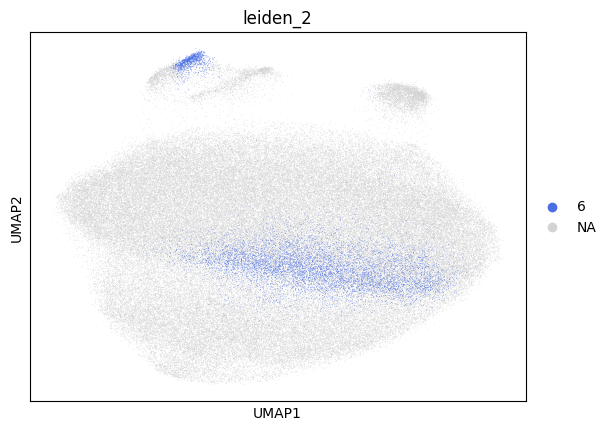

In [218]:
sc.pl.umap(adata, color = 'leiden_2', groups = '6')

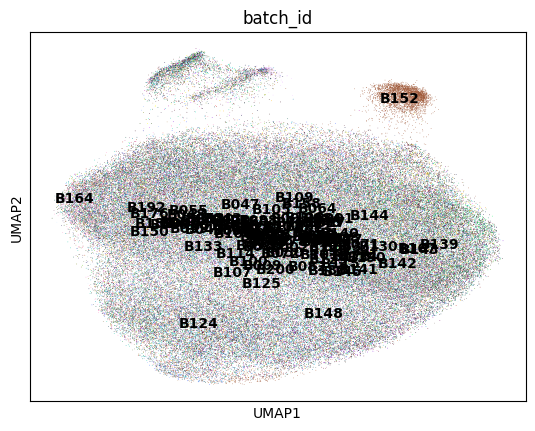

In [219]:
sc.pl.umap(adata, color = 'batch_id', legend_loc = 'on data')

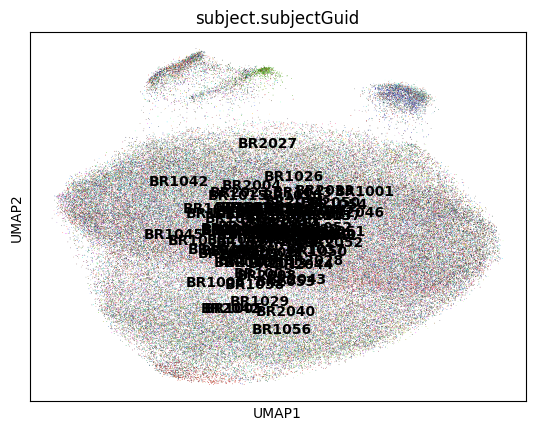

In [220]:
sc.pl.umap(adata, color = 'subject.subjectGuid', legend_loc = 'on data')

### Marker expression

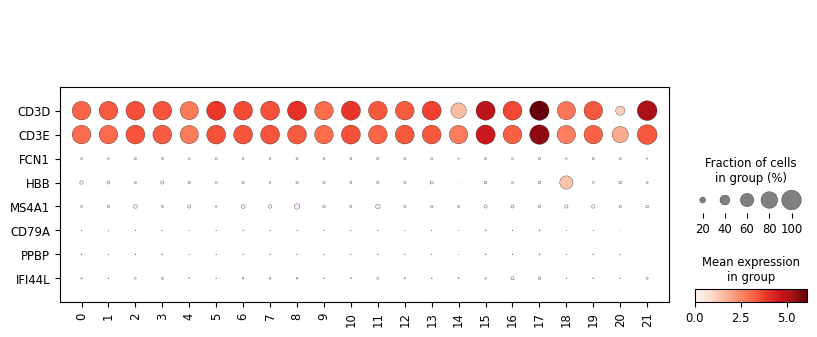

In [221]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = broad_markers, swap_axes = True)

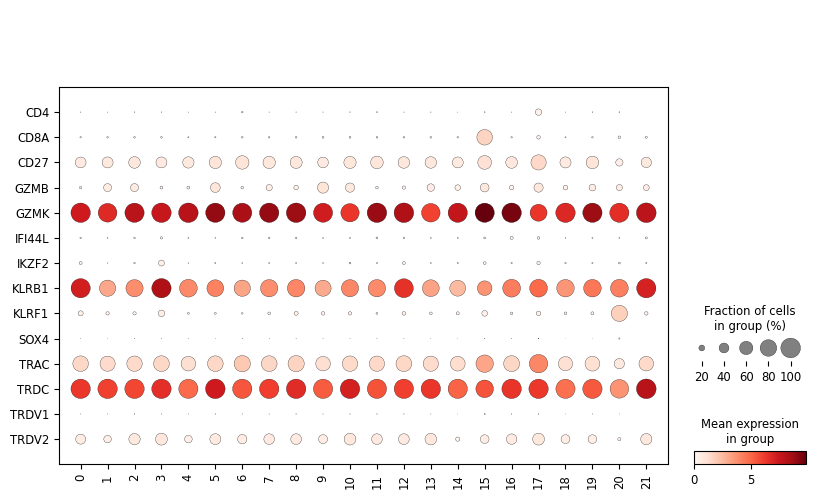

In [222]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = class_markers, swap_axes = True)

### Outlier investigation

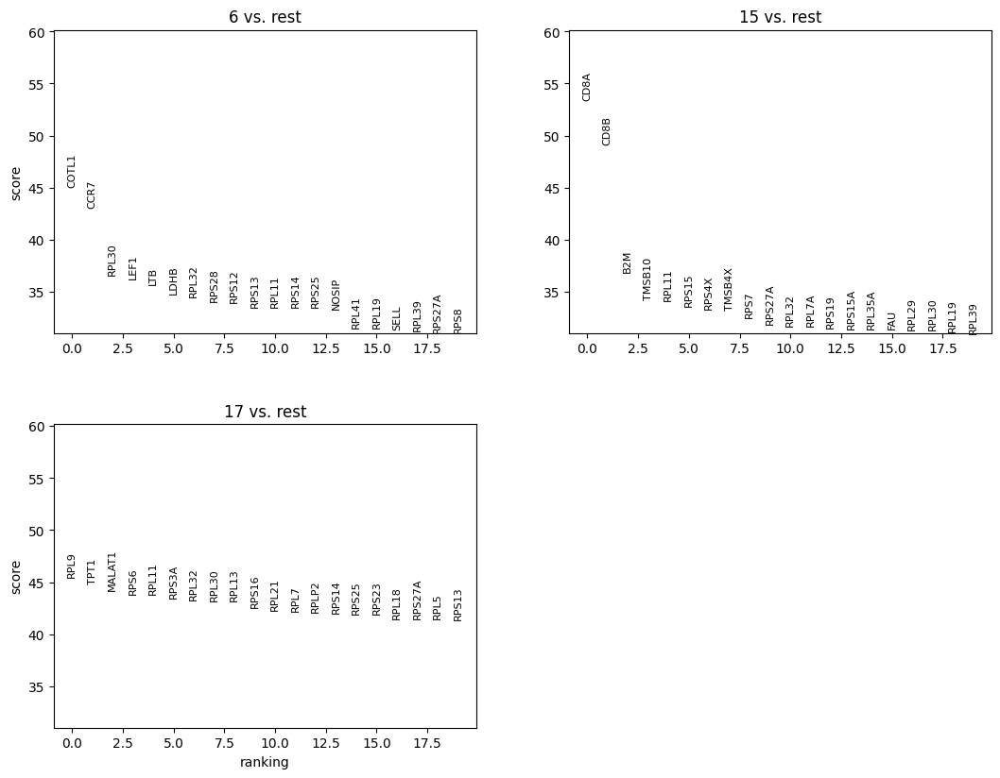

In [223]:
sc.tl.rank_genes_groups(
    adata, 
    groupby = 'leiden_2', 
    groups = ['6','15','17']
)
sc.pl.rank_genes_groups(adata, ncols = 2)

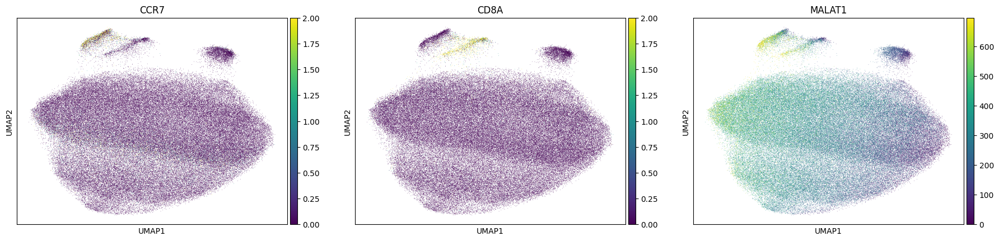

In [224]:
sc.pl.umap(adata, color = ['CCR7','CD8A','MALAT1'], vmax = 'p99')

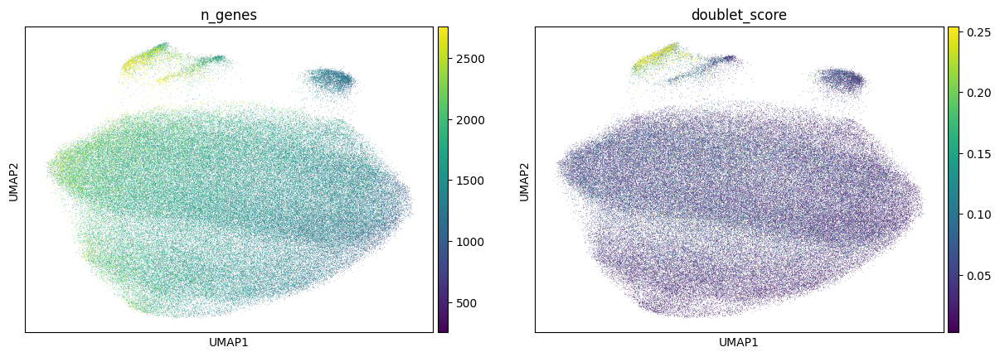

In [225]:
sc.pl.umap(adata, color = ['n_genes', 'doublet_score'], vmax = 'p99')

### Comparison to original labels

In [226]:
adata = add_labels(adata, original_df)

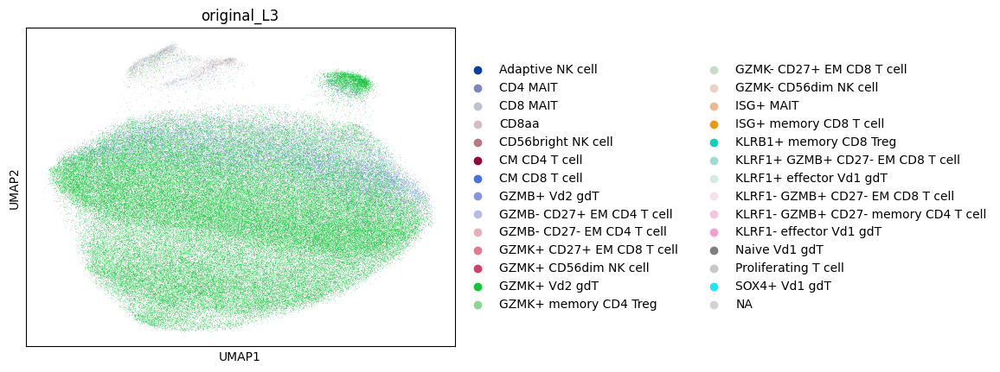

In [227]:
sc.pl.umap(adata, color = 'original_L3')

In [228]:
adata.obs['original_L3'].value_counts(dropna = False)

original_L3
GZMK+ Vd2 gdT                           106826
GZMB+ Vd2 gdT                            15540
NaN                                       5754
GZMK+ CD27+ EM CD8 T cell                  752
CD8 MAIT                                   602
CM CD8 T cell                              131
GZMK+ CD56dim NK cell                       97
GZMB- CD27+ EM CD4 T cell                   63
KLRF1- GZMB+ CD27- EM CD8 T cell            60
KLRF1+ GZMB+ CD27- EM CD8 T cell            58
CD8aa                                       56
KLRF1+ effector Vd1 gdT                     25
ISG+ MAIT                                   24
KLRF1- GZMB+ CD27- memory CD4 T cell        22
KLRF1- effector Vd1 gdT                     18
CD4 MAIT                                    15
Adaptive NK cell                            10
Naive Vd1 gdT                                9
KLRB1+ memory CD8 Treg                       8
GZMK- CD27+ EM CD8 T cell                    6
CD56bright NK cell                           5
G

In [229]:
adata.obs['original_L3'].value_counts(dropna = False) / adata.obs.shape[0]

original_L3
GZMK+ Vd2 gdT                           0.821113
GZMB+ Vd2 gdT                           0.119447
NaN                                     0.044228
GZMK+ CD27+ EM CD8 T cell               0.005780
CD8 MAIT                                0.004627
CM CD8 T cell                           0.001007
GZMK+ CD56dim NK cell                   0.000746
GZMB- CD27+ EM CD4 T cell               0.000484
KLRF1- GZMB+ CD27- EM CD8 T cell        0.000461
KLRF1+ GZMB+ CD27- EM CD8 T cell        0.000446
CD8aa                                   0.000430
KLRF1+ effector Vd1 gdT                 0.000192
ISG+ MAIT                               0.000184
KLRF1- GZMB+ CD27- memory CD4 T cell    0.000169
KLRF1- effector Vd1 gdT                 0.000138
CD4 MAIT                                0.000115
Adaptive NK cell                        0.000077
Naive Vd1 gdT                           0.000069
KLRB1+ memory CD8 Treg                  0.000061
GZMK- CD27+ EM CD8 T cell               0.000046
CD56brig

### Proposed updates

- Remove CD8A-high cluster as mislabeled? Or are these a CD8+ Vd1 type?
- Remove Doublet score-high cluster as doublets

## Review Proliferating T cell

In [230]:
cell_type = 'Proliferating T cell'
type_uuid = search_df['id'].loc[search_df['AIFI_L3'] == cell_type].tolist()[0]

In [231]:
type_uuid

'b3b66ced-cfcb-4b15-9edb-faffe931efd9'

In [232]:
adata = read_adata_uuid(type_uuid)

### Clustering

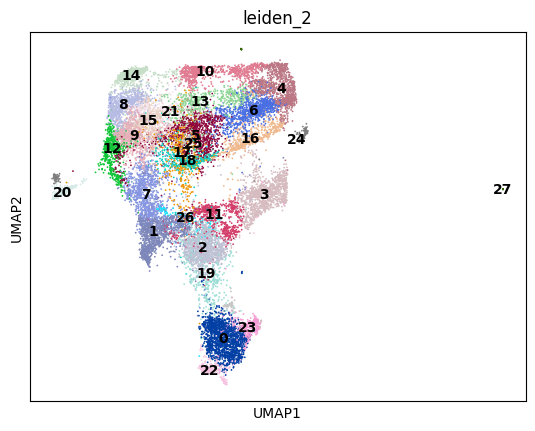

In [233]:
sc.pl.umap(adata, color = 'leiden_2', legend_loc = 'on data')

### Marker expression

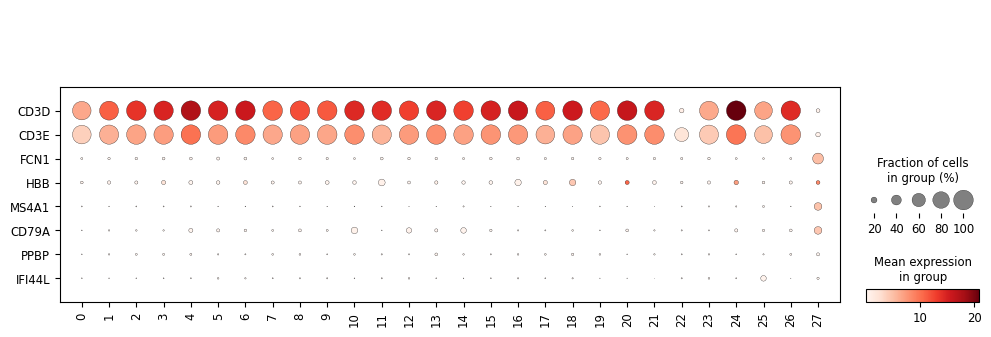

In [234]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = broad_markers, swap_axes = True)

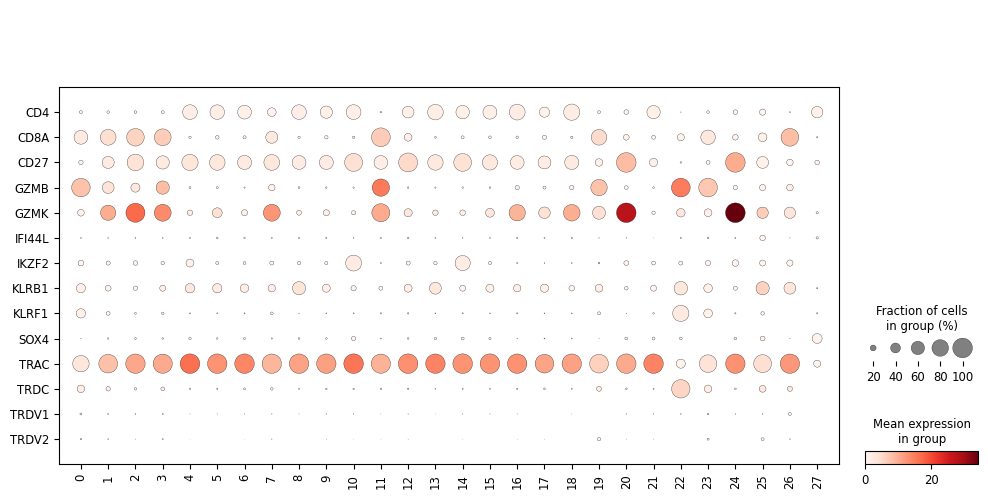

In [235]:
sc.pl.dotplot(adata, groupby = 'leiden_2', var_names = class_markers, swap_axes = True)

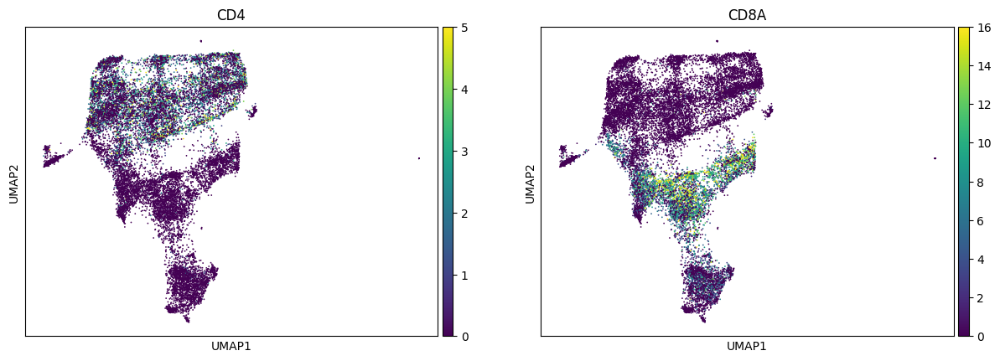

In [236]:
sc.pl.umap(adata, color = ['CD4','CD8A'], vmax = 'p99')

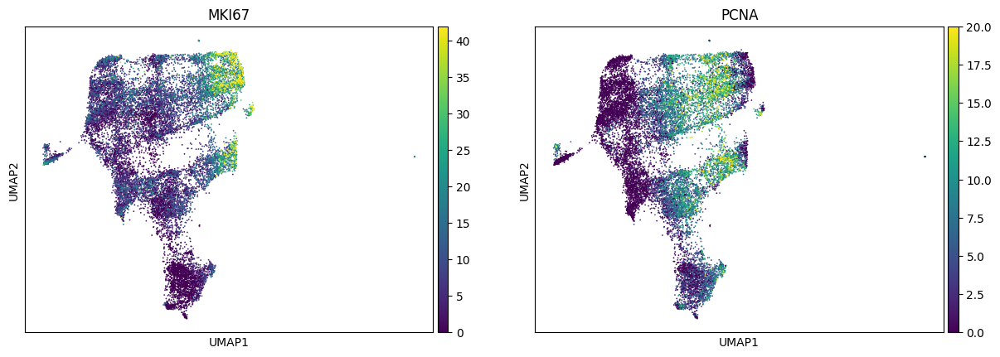

In [237]:
sc.pl.umap(adata, color = ['MKI67','PCNA'], vmax = 'p99')

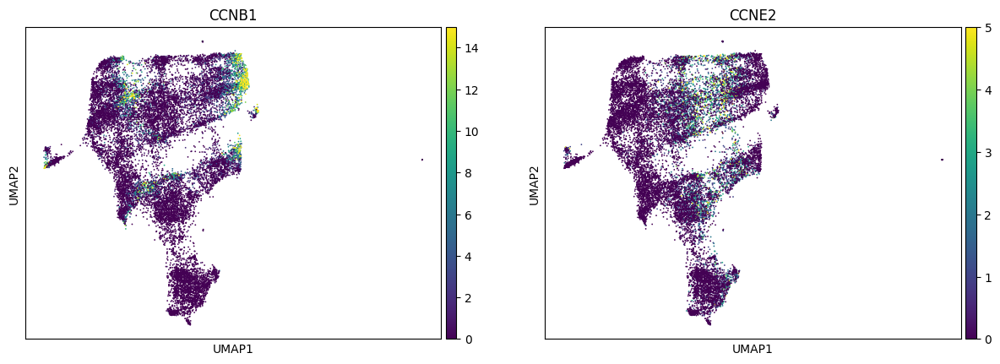

In [238]:
sc.pl.umap(adata, color = ['CCNB1','CCNE2'], vmax = 'p99')

### Comparison to original labels

In [239]:
adata = add_labels(adata, original_df)

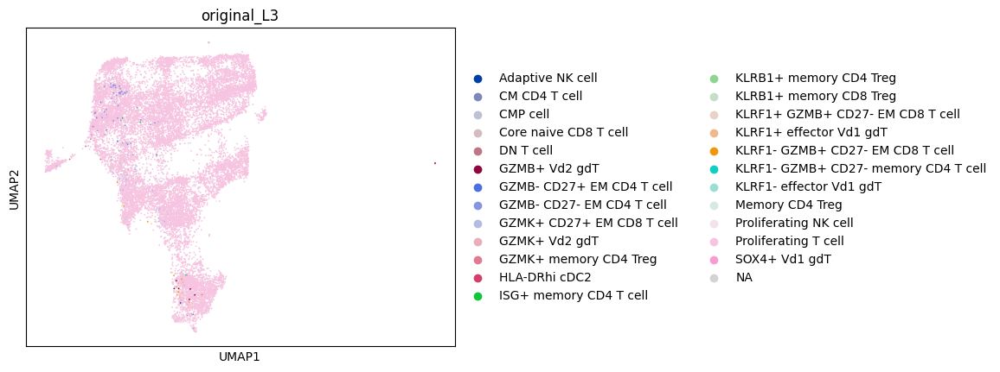

In [240]:
sc.pl.umap(adata, color = 'original_L3')

In [241]:
adata.obs['original_L3'].value_counts(dropna = False)

original_L3
Proliferating T cell                    17946
Proliferating NK cell                     135
NaN                                       102
GZMK+ CD27+ EM CD8 T cell                  80
GZMB- CD27- EM CD4 T cell                  62
KLRF1- GZMB+ CD27- EM CD8 T cell           21
CM CD4 T cell                              19
HLA-DRhi cDC2                              16
Adaptive NK cell                           11
KLRF1+ effector Vd1 gdT                     8
KLRF1+ GZMB+ CD27- EM CD8 T cell            7
DN T cell                                   7
GZMB+ Vd2 gdT                               6
KLRB1+ memory CD4 Treg                      5
Memory CD4 Treg                             4
KLRB1+ memory CD8 Treg                      2
KLRF1- effector Vd1 gdT                     2
Core naive CD8 T cell                       2
ISG+ memory CD4 T cell                      2
GZMK+ Vd2 gdT                               1
GZMK+ memory CD4 Treg                       1
GZMB- CD27+ EM CD4 T c

In [242]:
adata.obs['original_L3'].value_counts(dropna = False) / adata.obs.shape[0]

original_L3
Proliferating T cell                    0.973052
Proliferating NK cell                   0.007320
NaN                                     0.005531
GZMK+ CD27+ EM CD8 T cell               0.004338
GZMB- CD27- EM CD4 T cell               0.003362
KLRF1- GZMB+ CD27- EM CD8 T cell        0.001139
CM CD4 T cell                           0.001030
HLA-DRhi cDC2                           0.000868
Adaptive NK cell                        0.000596
KLRF1+ effector Vd1 gdT                 0.000434
KLRF1+ GZMB+ CD27- EM CD8 T cell        0.000380
DN T cell                               0.000380
GZMB+ Vd2 gdT                           0.000325
KLRB1+ memory CD4 Treg                  0.000271
Memory CD4 Treg                         0.000217
KLRB1+ memory CD8 Treg                  0.000108
KLRF1- effector Vd1 gdT                 0.000108
Core naive CD8 T cell                   0.000108
ISG+ memory CD4 T cell                  0.000108
GZMK+ Vd2 gdT                           0.000054
GZMK+ me

### Proposed updates

- Remove tiny cluster 27 as Mislabeled
- Look at these cells more because they're pretty cool